In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import re
from konlpy.tag import Okt 
from ckonlpy.tag import Twitter #prompt에서 pip install customized_konlpy 로 패키지 설치
import urllib3
import json

In [2]:
#크롤링한 데이터 파일 불러오기
#중복제거 및 널값제거 
df = pd.read_csv('./crawling_치즈볼_from20200101_to20201015.csv', index_col=0)
df.drop_duplicates(inplace=True)
df.dropna(subset=['title'],how='any',inplace=True)
df.reset_index(drop=True, inplace=True)
print(df.info()) 

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18779 entries, 0 to 18778
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   title   18779 non-null  object
 1   date    18779 non-null  object
dtypes: object(2)
memory usage: 293.5+ KB
None


In [3]:
#한국어에 사용할 토크나이저
twitter = Twitter()

c:\users\023\anaconda3\envs\machinelearning\lib\site-packages\konlpy\tag\_okt.py:16: UserWarning: "Twitter" has changed to "Okt" since KoNLPy v0.4.5.
  warn('"Twitter" has changed to "Okt" since KoNLPy v0.4.5.')


In [4]:
#토큰화에 제외할 단어 토크나이저 딕셔너리에 추가 
twitter.add_dictionary(['뿌링클','맛스타그램','먹스타그램', '맛스타', '푸라닭', '치킨스타그램', '메이플버터갈릭', '메이플버터', '크림치즈볼','메이플버터갈릭치킨','메이플갈릭', '맛집스타그램', '먹방스타그램', '스타그램', '인스타', '또래오래', '배달의민족','배민', 'instagram', '뿌링클', '고추바사삭', '뿌링뿌링','뿌링뿌링소스' ,'뿌링소스', '또래오래', '인스타 그램','인스타그램', '황금올리브','네고왕','맘스터치','에어프라이어','블랙치즈볼','블랙알리오','청년치킨','청년피자'], 'Noun',force=True)

#for word in imp_wrd['important_words']:
#    twitter.add_dictionary('{}', 'Noun').format(word)
    




In [5]:
#딕셔너리 추가된 것 테스트 
twitter.morphs('일주일만에 다시 찾은 뿌링클 맛스타그램 네고왕')

['일주일', '만에', '다시', '찾은', '뿌링클', '맛스타그램', '네고왕']

In [6]:
#stopwords 현 디렉토리에 추가 해야함 
stopwords = pd.read_csv('./stopwords_trend.csv',  encoding='CP949' ,index_col = 0) 
print(stopwords.head())
print(stopwords.tail())


  stopword
0        아
1        휴
2      아이구
3      아이쿠
4      아이고
    stopword
673       어도
674       다가
675       처음
676       사진
677       환영


In [9]:

#형용사와 명사만 남길경우 사용 
cleaned_sentences = []

for sentence in df['title']:
    E_sentence = re.sub('[^a-zA-Z]',' ', sentence)  #영어텍스트를 띄어쓰기 기준으로 토큰화 
    E_token = E_sentence.split(' ')
    K_sentence = re.sub('[^가-힣]',' ', sentence)  #한글텍스트를 토큰화 
    K_token = twitter.pos(K_sentence)
    K_token = pd.DataFrame(K_token, columns=['word','class'])   #토큰화된 한글텍스트를 다시 데이터프레임으로 만들기
    K_token = K_token[(K_token['class']=='Noun')|(K_token['class']=='Adjective')] 
    token = E_token + list(K_token['word'])    #토큰화된 한글, 영어텍스트를 합치기 
    cleaned_token = pd.DataFrame(token, columns=['word'])   #합친 것을 다시 데이터프레임으로 만들기 
    words = []
    for word in cleaned_token['word']:  #불용어 제거 
       if len(word)>1: 
          if word not in (list(stopwords['stopword'])): 
              words.append(word)
          else: print(word) 
       else: print(word)    
    cleaned_sentence = ' '.join(words)
    cleaned_sentences.append(cleaned_sentence)

df['cleaned_content'] = cleaned_sentences


















































애
씨
오늘
입니다


































































































































애
여러분
거의























































































애
이런
거
















































































애
더
킹
리얼



























애
















































애
움













































애
그냥
내
볼
담

































































































애
같
습
짱
좋
아하
데
리뷰
선
후
율
번
포
미







































애
내
좋아요














































애
진짜














































































애
전
다만
육
입니다








































































애
같
습
업
우리
요


































애
같
습
입니다








































































































































































































































뭘
제
님
귀
셔
게
저
거
면서
돌
오늘
용




























































































뭘
진짜
맛있
어요
저



























































뭘
진짜






























































뭘
징
뎅




























































































































































































뭘
왜
내
좋
아하
이
진짜
것
눈
것
저
데
것
앞















































뭘
등











































































o

뭘
진짜
좋
아하
데
저
하나
다
맛










































뭘
눈











































































뭘
계
콘
진짜
단
역시
두
분







































































































































맘
집
내
더
맘
맛있
어보
맘
표




































































맘
집
내
더
맘
맘












































































































































맘
집
내
더
맘
정말
다가
린
진짜
어요
진짜
맘
조금
정말
요






































































맘
집
내
더
맘
맘
린
어요




















































































맘
집
내
더
맘
비
진짜
진짜
다음
어요





































































맘
집
내
더
맘
분

































































맘
집
내
더
맘



















































































맘
집
내
더
맘
맘
거
도












































































맘
집
내
더
맘
저
맘
스










































































창
무슨
다음
없다


맛있
추가
배
더
맛있
어요
닝


























































































































































































시간
맛
보
다가
어서
혼자
중
생각
어요
퓨
앞
구
까지
새
팬






























































































시간
맛
제
좋
아하
용






































































































시간
맛
다가
더
조금
드




















































































































시간
맛
어서
그냥
귀
어요










































































시간
맛
요
































































































































시간
맛
그
완전
조각
어요
님
볼
쏙
전
느낌
랄


































































시간
맛
거
같은
뎅







































































































































맘
어요
표
더
맘
맜







































































맘
어요
표
더
맘
어요















































































맘
어요
표
더
맘
좋
아하
데






















































































































































윤
윤
리뷰
초
초
터
다음
또






















































































































윤
윤
리뷰
역시
요
후
까지
뭐
맛






































































































윤
윤
리뷰
역시
풀
있
어서
나
오







































































































































윤
윤
리뷰
님
음식
저
왜
뒤
뒤
여
오늘
























































윤
윤
리뷰
뻐












































































윤
윤
리뷰
혹시
내

















회
태
부터
고
비
진짜
어요















































































































































술
떡
떡
회
태
못
구
어요
첫
부터
까지
겅
























































































































술
떡
떡
회
태
루
진짜
요
무슨
점
왜
난
영
성
짱

































































































술
떡
떡
회
태
자기
말
확
쿠












































































술
떡
떡
회
태






































































































술
떡
떡
회
태
병
날
옄












































































술
떡
떡
회
태















































































술
떡
떡
회
태
다가


























































































































































































턱
밥
준




























턱
밥
준
오늘
밥
컹



























턱
밥
준
어서











































턱
밥
준
개
개
맛
듯






















턱
밥
준
알
밥















































턱
밥
준
형
좀
느
어요
진짜
밥




















턱
밥
준
밥






























턱
밥
준
게
매번

































































봉
메뉴
꿀
까지
개
분
처음













































봉
메뉴
꿀
까지






































봉
메뉴
꿀
까지




































봉
메뉴
꿀
까지



































봉
메뉴
꿀
까지



















































봉
메뉴
꿀
까지











































































봉
메뉴
꿀
까지
그
걸



































봉
메뉴
꿀
까지



































I
봉
메뉴
꿀
까지






































































봉
메뉴
꿀
까지
찍
어서
게
제





































봉
메뉴
꿀
까지






















































EATING









진짜
입
맛
리얼



































EATING












진짜
입
맛
리얼
형
졸
잔



































EATING



















진짜
입
맛
리얼
좋
없
어서



































EATING









진짜
입
맛
리얼



































EATING








진짜
입
맛
리얼
형



































EATING























진짜
입
맛
리얼
현
왓



































EATING


















진짜
입
맛
리얼
좋아요
만



































EATING















































진짜
입
맛
리얼
형
더

























































맛
분
타인
생
첫
타
바로
인





























































































맛
분
타인
생
첫
타
요
이런
맛
맛
죽
그
거

























































맛
분
타인
생
첫
타
면서
난
걸
왜





























































































맛
분
타인
생
첫
타
말
첫
때
알
수
요
타
이런
맛
처음
































































































킹
저
전
전
맛있
어보























































































































































킹
저
전
또
다른
기
오늘
타
보


























































































킹
저
전
컵
얼마나
















































































































킹
저
전
글
웡
해




























































































킹
저
전
언제
생
데
















































































































































킹
저
전
게
바로
자
워
만
맛
음식
맛
우리
욥
































































































킹
저
전
어요
물
울
어요












































































































































































맛
다른
건


































































































































맛
진짜
비록
내
사
먹기









































































맛
말



























































































맛
이














































































맛
철
씨
씨
진
생
생






























































떡
떡
까지
걸
약간













































떡
떡
까지
이
느낌


























































































































































































떡
떡
까지
형
진짜
형
막
술
진짜
형
젠
중
형
부터
어도
포
거
보
형
꼭

































































떡
떡
까지
생각
멋







































떡
떡
까지
늘
같은














































































































































웨
제
살
때
맛
어도
다가
멈


































































































































웨
마음대로
이
얼마나
쇳
얼마
다시
빼
노
























































































웨
눈
운
헬




























































































웨
어떤
살
보
고
살
다가
못
그냥
생각
































































































웨
혹시
생각
생각













































































웨
허걱

















































웨
리
























































































웨
평
있다
알











































































웨
더
좋아
바로
손
겈
어요



















































































































EATING
i
i
떡
떡

































EATING

a
떡
떡

































EATING




































































떡
떡
집
해도
저
같은
분
그냥
저

































EATING
u
떡
떡

































EATING








































떡
떡

































EATING















































떡
떡

































EATING



















떡
떡

































EATING
떡
떡
























































만큼
님
교































































































만큼
그
얘
같은



















































만큼

























































만큼
오늘





















































만큼
두
술
뭐
































































만큼
만
설사
나
눈
이상

















































EATING






























EATING

















































안
어요
것





















































양
난
까지
율


























































양
난
까지
율






















































양
난
까지
율































































양
난
까지
율























































양
난
까지
율










































































양
난
까지
율





















































a
a
양
난
까지
율


















































































양
난
까지
율































































양
난
까지
율










































































양
난
까지
율
















































































양
난
까지
율





















































양
난
까지
율


























리얼























리얼



















































리얼
어요
























리얼
























리얼


















































리얼
날
볼
리얼







































리얼
이
시간
걸

























리얼
























리얼























i

리얼












































































































리얼
킁
삭
삭
언제
용























리얼























리얼























리얼

























리얼
























리얼

























리얼










































번
저
어서
개







































번
저
어서
꾼












































































번
저
어서
형
옷
오늘
옷
난
형













































번
저
어서
또





































번
저
어서
산
















































번
저
어서
어디
욬








해
데
심
























































































댁
먹기
불
말









































































댁
먹기
불
탕
비
연










































































댁
먹기
불
탕










































































































댁
먹기
불
탕
진짜
우리
같다
것
귀







































































댁
먹기
불
탕
생




















































































































댁
먹기
불
탕
진짜
알
우리
어요
오늘










































































































댁
먹기
불
탕
입
때
이
진짜
이






























































































댁
먹기
불
탕
둘
역시







































































댁
먹기
불
탕
면






































































































EATING





삭
돈
산
볼
삭





































EATING




I
삭
돈
산
볼
삭





































EATING





I
a
삭
돈
산
볼
삭





































EATING




삭
돈
산
볼
삭





































EATING









삭
돈
산
볼
삭





































EATING





삭
돈
산
볼
삭





































EATING




삭
돈
산
볼
삭





































EATING




삭
돈
산
볼
삭





































EATING




삭
돈
산
볼
삭





































EATING




삭
돈
산
볼
삭





































EATING




삭
돈
산
볼
삭
























































































시
역시
내
리뷰
신
메뉴
츠
더
미
간
훅
어요





















































































































































































































시
역시
내
리뷰
신
메뉴
진짜
까


























































































































전
있
어요
적
복
입니다
생각






































































































어서
저
까지
좋아요
몸
땐
때
배
이상
더








































































님
역시
완전






















x













거






















x















































































거
다른
봄
욕






















x

















































거
형
계
좀






















x













































거
개
진짜
걸
그냥






















x

















































































거
닠
형
고
계
안
있
어서
짤
겨
작
한마디






















x
















































거
때
캬
억
형






















x



















































































거
형
형
진짜
형
워
앞























x


x































































































































발
궁
돌
린
일상
탕
앤
스
이상
여
수
알
옵
















x


x



































































































발
궁
돌
린
일상
탕
앤
스
진짜
귀
좋아
살
















x


x




























































































g



















발
궁
돌
린
일상
탕
앤
스
좀
빠
것
같
어요
















x


x























































































발
궁
돌
린
일상
탕
앤
스
연
처
나
번
















x


x























































발
궁
돌
린
일상
탕
앤
스
















x


x







































































































발
궁
돌
린
일상
탕
앤
스
재
거
생
연
처
못
신
















x


x







































































발
궁
돌
린
일상
탕
앤
스
자신











걸






























































































































































































































































































































































































윙
탕
혹시
디
맛있
습
이
안
매
면
리얼
핫
거
좀
추천
추천
것
안
제
추천
저
두
둘
중
리얼
핫
조금
더
거
보
다가
입
침
가득
머
앞
전
또
있
어요








































































































































































































윙
탕
까지
과
다가
보
면서
제
거
오늘
메뉴
진짜
어떻게
저
여
정말






















































































































































































윙
탕
좋
아하
유
어서
요
오늘
터
어서
습
진짜
맛있
어보








































































































































































리얼
메
저
색
요
자마자
얼
무엇












































리얼
어서
어요











































리얼
진짜
좋아요
















































































리얼
정말
좋
아하
데
닝
맛있
어보
전






















































































볼
맛
아이
거
정말
좋
아하
어요






























































































볼
혼자
드
만
침
맛
샘
오랜만
입니다
아이














































볼
오늘
맛











































































볼
오늘
것
정말
맛있
어요
간
요



























































































볼
장
입니다
어요
오늘
음식
얼
요


























































볼
아이
쿠
생각


























































볼
인






































볼



































































꿀
만
앞
침
완전
웡




































꿀
처음
부터
웤























꿀
























꿀



































꿀
턱








































































































꿀
멍
젠
때
봉

































꿀


















































꿀
맛
거
많
그냥

































꿀























꿀



















































꿀
진짜






































꿀
잌
왜























































꿀
꿀
턱
같은





































































몇
안
찍
때
언제
보
키
몇




































르
같은
느낌
적
느낌








































쭉









































내
점
옷
워































거







































































거
빵
때
목
빵
게






































































































































































분
빵
핫
살
빠
것
저
어요














































































































분
빵
핫
옷
거























































































분
빵
핫


























































































































































분
빵
핫
꼭
빵
저
있
어서
이번
주
정말
빵










































































































































분
빵
핫
운
인
시간





































































































분
빵
핫
앜



























































































































분
빵
핫
오
있
어요
땐
좋아요




















































































































어요
핫
용
모
오









































































어요
핫
첫
저
있
어요
좋
톤






















































어요
핫
봣
































































































































어요
핫
이번
맛
면서
방
뇨
전
이
만약
손
숫
다른
손
기타





















































































어요
핫
그냥











































































어요
핫
얘
거
모




































































어요
핫
울
비
씨



















































어요
핫






























































































어요
핫
핫
때
단





















































































































































어요
핫
저
중
말
데
없
어요
잠시
편
저
























































































마
살
마
링
품
술






















































마
살
마
링
앜














































































































마
살
마
링
정말
다시



































































































마
살
마
링
날
더














































마
살
마
링































































































마
살
마
링
뼈
닭
좋
아하
데
순
듯
형
목
보
거

































































































마
살
마
링
이런
어요



































































마
살
마
링
오늘
정








































































































마
살
마
링
거
진짜
진짜
어요
저
링
저












































마
살
마
링























































마
살
마
링



























EATING













핫
















EATING
































핫
















EATING



















핫
















EATING







































핫
















EATING



















































































































핫
















EATING































핫
















EATING


























































































핫
















EATING

























핫
















EATING














































핫
















EATING










































핫
















EATING

















핫
















EATING

































핫
















EATING



a

핫
















EATING






















핫
















EATING





핫

















































역시
날
배







































EATING
o

s

메뉴
떡
떡






































EATING

o
n
o


메뉴
떡
떡






































EATING








































































































































메뉴
떡
떡






































EATING
m


메뉴
떡
떡






































EATING





































메뉴
떡
떡






































EATING


s

메뉴
떡
떡






































EATING
o
s
o

메뉴
떡
떡






































EATING
e
메뉴
떡
떡






































EATING











































































메뉴
떡
떡






































EATING


메뉴
떡
떡






































EATING
















메뉴
떡
떡






































EATING
a
a
메뉴
떡
떡






































EATING



























메뉴
떡
떡






















































































































































































토
월
집
각
두
전
잎
내
피
역시
찰














































































































옥
가득
거
아이
늘







































































































팝
닝
진짜







X




































































































후
개
개
약간
닭
알
느낌





















































































































입니다
메뉴
추천
개
것
이런























































































































위
닝
어요
반
수
일단
부터
어보












































































































자
킨
메뉴
주문
어요
요
살
산














































































































































































느낌
고
다른
데
알














































































































굽
양
조금
부
데
처음
생각
맛
























































































































주문
황
안
까지
빵
같은
느낌
적
좀
슴
황
부터

















































































































오늘
입니다
많은
누구
좋
아하








































































g



















































언제
덕
팁
떡
때






































































































조각
개
원
비
원
까지
함
진짜
전











































































































자
킨
리뷰
내
처음
맛
없다
심지어
식
어서
약간
떡
안














































































































































계
추
메뉴
볼
수
어서
좋아요
듯
입
어보
뭐
뭐












































































































핫
계
어요
전
계
어요
듯
해
적
어요
고
좀
덜
역시
조금























































































































마리
추가
까지
산
인
마리
추가
추가
어요
법
어서
처음
분
즐
수

































































































굿
진짜
맛있
어요
겉
오
면서
안
맛
확
이


































































































무엇
양
옷
그

























































































































돈
산
추천
나
이
맛
주문
메뉴
시간










































































































어
점
또한
어서

















































































































우리
상



















































































































황
마리
저
부터
왜
요
향
안
그냥
향



































































































볼
안
맛
맛
느낌
도
노
어서
겉















































































































콥
후
진짜
때
음식
그러니
걸





































































































닭
살
윙
닭
있다
개
개
봉
개
개
왜
고












































































































집
나
것
고
















































































































너
맛있
추가
입
뭅
떡
떡
구
그

























































































































볼
수
놈
메뉴
케
주문
































































































































































































































역시
색
입
맛
면서
안
게
어요
제

























































































땐
고



































































































노
적
없
어서
번
진짜
옷
뭐
저
볼
데
























































S





































































노
돈
산
핑
주문
볼






















































































































피
추천
기
안
약
달
면서
맛
저
봉

































































































































솔
맛
저
번
조각
번
조각
반
마리












































































































점
보
추천
요
개
원
작
닝
있
어서
좀
잡
유






























































































































































































































집
개
데
진짜
왕
가득
집
집
강






























































































곳
맛
때
부터
치
조금
적
위



























































































































메뉴
추천
마
맵
오
못
아이
자
왕
나













































































































생각
맛
제
입
역시
역시
년
맛
요
다른
메뉴







































































































거
왜
맛있
어요
완전
입니다
번
닝
진짜





































































































모두


















































































































계
파
리뷰
계
계
파
어요
계
리뷰
진짜
어요
입


























































































































































































장
펫
어서
거
도
것
잠시





































R























































































살
원
개
원
팁
원
역시
가득
어요
좀
맛









































































































집
핫
어요
모두
얼마
어요
입
베
더
쥬













g
















g

















































































개
개
원
특
년
월
일
시
분
입니다
기타






























































































































먹기
알
해
고
제
추가
리얼
개
원
볼































































































































메뉴
떡
다음
갸
볼
뭐
임
볼
어요
맵
생각
겉


















































































































핵
요
찌
개
있
어요
조금































































































































































리뷰
앤
핫
시
의
전
메뉴
및
밑
리뷰
추천





































































































음식
킨
오늘
점
메뉴
킨
맛




























































































쪽
그런
비
때
시
시간
꼭










































































































































신
메뉴
맛
개
맛
중
앱
꼭
개
부터
추천
개
널
맛
유
개
살
개















































































































킹
주문
점
입
물
겉
면서
폭
고
면서

















































































































언제
어도
킹
살
다른
곳
겉
안
까지
를
곳
역시






























































































































밥
밥
런
없
어서
조금
가득
우선
주문
못

















































맛있
어요
아하
데
주문
등
























































































































피
느낌
속
안
없고
완전
좀
맛





























































































메뉴
진짜
추천
함
나
면서
안
거
캬








































































































개
비
더
고



















































































































스
개
물
개
스
스
개
물
개




































































































































칠
킨
피
이
집
데
것
더
저
이
도







































































































메뉴
오늘
부터
어보
떡
메뉴


























































































































계
더
효
럼
조금
같은
안
입
어디
효
이





































































새
온
신
메뉴
킨
싹
난
듯
다만
좀
약
어요
막
고
굳
어서



























































































노
안
같은
맛
어디
점





































































































































그냥
요
손
안
어서
더
록
던
던
집






















































































































자
킨
살
마
만
비
맛
파





























































































































인
톡
주문
개
개
꼭
맛
입
속
가득
겉
속

































































































































점
살
먹기
살
살
원
순
약간
느낌
도
안





























































































































살
굿
볼
수
있다
분
데
굿
개
개












































































































제
산
구
여기
일
분
이런
뭐














































































































못
요
제
뇌










































































































저
쓱
원
구
것
추천
사진
가득
알












































































































마
뼈
주문
어요
총
원
어요
개
까지
약간
다른
곳





























































































































자
킨
반
까지
맛
메뉴
추천
돈
산
리뷰
어요
말
옷
맛있
어요


























































닝
파
홀
알
원










































































































































집
리뷰
역시
맛있
어요
다가
안
가득
꽤
어요


































































































료
산
산
수
떼
유



































































































































































반
고
넷
난
개
완전
내
다른
분
어서
쥬


































































































메
츠
원
메
배
꿀
찍
더
메
내



















































































































































달
필
노
칙
뿐
진짜
이
맛
도
이
화
여기































































































주문
함
내
적
맛
맛
이번
가득





















































꽉
홀
알
원




















































































































































돈
산
신
메뉴
조각
개
반
마리
어요
개
좋
아하
시
개
다른
저
좀























































































































팥
저
오늘
엘
신
얼마
입
까지





































































































떡
떡
거
완전
더
흥
거
이
글
저
같은








































































































































































메뉴
수
신
메뉴
주문
입니다
배
업
































































































사진
곳
없
어서
어디
다시
아야
내
없
어서
옆
칸






















맛
해









































생
흐흐










































홈



















































































































































월
주
새
새
세
편
맛
노
안
분
생각
함
생각
그냥
날
월
기
노
거







































































































리뷰
점
왜
리뷰
하나
여기
맛있
완전












































































































계
밥
계
봉
주문
양
꾀
처음



















































































































































































































추천
요
가득
어서
어요
집
집






















































































것
고
나
안
역시
나
더
밥






















































































주문
어요
입니다
원
개
어디
어도
것



















































































그냥
맛
추천
맛
다만


















































































맛
유
산
음
어보
데
손
그냥
손
















































































































볼
역시
갓
준




















































































무
향
비
쪽
























































































저희
이
메뉴
중
뚝
등
드





















































































만큼
맛있
어요
안
진짜










































































































































































계
계
점
까지
습
개
개
더













































































































볼
때
해도
또
적
덕
맛
데
이








































































































전
부터
번
어보
일
















































































































옥
게다가
안
머
정말
게
몇
개
배
느낌
츄
옥













































































































아이
칩
그
때
칩
부터
나
이
칩












































































































































살
냉
등등
살
롤
오늘
어요




























































































































월
새
고
슈
말
폭
맛있
어요
집
살
쿵

























































































































































또
다른
또
다른
오늘
역시
로
어요
도






































































































까지
고
느낌
제
사진
해












































































































입
쏙
그
맛
안
좋
아하
난
이
더
원
꿀


































































































킹
꿀
입
킹
단









































































































오늘
음식
메뉴
추가
전
안
고
무슨
오
물










































































































종
일
은
악
맛
맛
약간
콤







































































































주문
님
맛
다가
사진


































































































킹
오랜만
어요
킹
고
생각
연
어요
어떻게






















































































































게
고
좋
아하
움
배
뒤
















































































































및
볼
수
고
안
게
안
점
알
저희
메뉴
요
개
원










































































































반
향
맛
좀
맛
향
듯
좋
아하
만
개
깨
이

















































































































살
마
기
뭐
완전
뭐
좋
앞





















































































































메뉴
짱
이런
그냥
하나
좀
수




















































































































추천
자
킨
뭐
좀
맛
생각
그
느낌
볼
생각
심
어요
짱
메뉴
















































































































메뉴
추천
고
알
입니다
것
메뉴










































































































































































원
종
안
볼
꽉
찬
입
옥
볼
유
해
















































































































리뷰
메
츠
리뷰
볼
거
다가
완전
메
츠
떡
































D

















































울
소
주문
생각
삶










































































































숨
명
내
맘
속
위
집
해
먹기
게
없다
떡
덜
더


















































































































볼
떡
떡
반
안
속
어요
볼
가득
다른
가득
어요
역시










































































































메
츠
식
다가
속
모
당
겉
그













































































































자
킨
치
링
우리
파
말
자
킨
뿌
어요
치
링

























































































식
어서





























































































리뷰
정말
짐
유
제
정말
살
걸
알
수
맛




























































































빨
떡
점
빨
떡
추천
빨
떡















































































































기
향
피
맛
사
다음
피








































































































건
점
이번
입
안
가득
가득
생각
것
쭈
욱
요
개
저





































































































































리뷰
오늘
날
맛
수
리뷰
어요
개
내
여기
얼마
여기
만큼
없다















































































































피
모
미
가득
입
짤












































































































마치
좋아
좋아
잔
맛있
다음
내













































































































카
년
월
일
원
원
좋





































































































율
소
까지
용
개
다른











































































































추천
메뉴
언제
어도
맛있
어요
가득
겉
면서
요
어도
맛있
어요
전










































































































리뷰
메
츠
거
메
츠
진짜
뭐
일단









































































































고
뭐
뒹
다가
통
분
후
닝



































































































굽
일상
나
중
하나
처
그냥
용
수








































































































닭
베
자
폭
닭
닷
어요
무엇
저
떡






















































































































떡
퀸
신
메뉴
핫
어요
막
좀
더
욤
좀

















































































































































































모
놈
놈
볼
놈
처음
빵
같
다가
함
맛
츠

























































































































월
주
일상
앤
스
왜
우리
기
함
영
양


























































































































메뉴
원
거
도







































































































점
듯
닝
진짜
데
개
고
함
고
뭐
그냥
















































































































월
일
꽝
쌤

















































































































점
및
겉
빵
같은
느낌
속
두
개
것
같은
맛








































































































다가
진짜
가득
앞
불
거
때
때
키
진짜









































































































































































































호
또
호
꼭
길
추천
용
더
밥



















































































































추천
안
어요
달
개
안
아하
데
달
































































































































런
안
살
킹
킹
킹
처음
달
맛
르
수




































































































바
메뉴
바
메뉴
팍
때
만큼
활
처음








































































































점
줄
약간
느낌
안
고
더
다음
날


























































































땐
갑
추가
주문
맛있













































































































오
정말
이상
안
생각
땋
이상
것
볼
수
있다
그
이상
































































































































































































처음
어보
았
처음
날
희
희
오늘
달
이
층
열















































































































신
메뉴
등



























































































































진짜
맛있
겸
말
볼
느낌
요
향
저
그냥




















































































































메
츠
집
그
전
메
츠
생각
어요
표



















































































































점
처음
안
조금
다른
느낌
느낌
내
각자

































































































부터
속
가득
짤
시
말
단
맛









































































































신
메뉴
핫
안
사진
어서
알
해
신
메뉴
핫


































































































































































































점







































































































오랜만
역시
혼자
땐
음식
켜
좋
아하
처음




















































































































리뷰
메뉴
신
메뉴
개
황
마리
볼
개
주문
말
앱
주문
값





























































































마
여기
이상
맛
돈
맛
맛





































































































































트
추천
피
살
점
어요
특
부터
약간
거
안







































































































아이
좋
저
좋
아하
거
집
어요
콕
찍
어서
어요











































































































































마
볼
코
맛
도
맛
볼
애
뼈
원
살
원
































































































































































반
마리
개
원
번
번
원
저
어서





















































































































집
좋
아하
오늘
볼
거
면
요



N


















































































































자마자
곳
자마자
안



























































































































남
안
핫
모
마
역시
같은
맛
단
마
































































































































땅
팁
못
맵
있
어서
어요
조금
채
느낌










































































































계
소
소
울
표
밥
임
꾹
계
소

























































































































주문
어요
저
같은
느낌
쭉
주문
제
좋
아하



































































































































































시
점
회
까지
세
명
시간
맛
닭
닭
말























































































































로
문
살
면서
처음
오늘
헬
입니다
온
모두
이런
맛
알























































점
저
이













































































































촉
꺄
진짜
아이
반
안
수
저
움








































































































고
안
역시
누가
앞
































































































속
좋
때
환
주
면서
추가





























































































































노
찰
안
어서
분
초
자
돌
처음
때











































































































메
츠
좋
메
개
원
편이
그
만큼
가





















































































































쉬
추가
종
맛
추가
주문
어요
주문
분
후













































































































원
콜
거
개
원
원
개
꼴
거



















































은
닙
친구






















































































































다른
친구
중
다른
친구
중
다른
친구
중




























































































































































이번
나
집
랩
개
더
줌
진짜
혼자
완전
진짜
혼자
떡
개
몇
조각
완전
거의




























































































































오늘
일상
먹기
원
원
원
까지
나
예
떡
떡
진짜
















































































































킹
킹
볼
가득
볼
입니다
사진


















































































































































사진
곳
없
어서
어디
다시
아야
내
없
어서
옆
칸






















맛
해









































생
흐흐










































홈



















































































































































월
주
새
새
세
편
맛
노
안
분
생각
함
생각
그냥
날
월
기
노
거







































































































리뷰
점
왜
리뷰
하나
여기
맛있
완전












































































































계
밥
계
봉
주문
양
꾀
처음














































































































피
꼭
친구
다만
악
봄
줄
생각






















































































































길
전
탕
밤
전
탕
베
시간





















































































































































안
옥
글



















































































자
킨
주문
리뷰
맛
전
맛
어요
자
킨
점
















































































































점
맛
개
안
어서
내
중
굽









































































팬
듯
입니다
제



















































































































추천
요
가득
어서
어요
집
집






















































































것
고
나
안
역시
나
더
밥






















































































주문
어요
입니다
원
개
어디
어도
것



















































































그냥
맛
추천
맛
다만


















































































맛
유
산
음
어보
데
손
그냥
손





































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
조금
바로
실
수
있
어서
어요
넉
어요
아이
도
수
있
어서
요
리얼
리얼








































































































































친
왜
어보
좀
진짜
처음
이
무슨
맛
얼마
전부
터
어서
트
거
걸
일
식
걸



































































































































딸
구
다가
다음
거
로
딸
구
다가
담
줄




























































































































































































































































































































































































































































































































































































































































































































































































컴
진짜
거
아하
데
날
진짜
처
생각
킨
스
면서
번
때
편
떡
떡
좋아요









































































































































































































































I
I






















































링
링









































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
리얼
품
쯤
생각
맛
리얼
리얼











































































































































































































































































































































































































































삭
친구
이상
니
오늘
집
어디
쪽
때
까지
술
다음
난

















































































































































































































































































































































































































































































































































































































































































































은
맛
어요



















































































































































화
널
웨
날
웨
감
























































조각
내
치
혼자
바
새
것
맛있
램













































































































L





진짜
리뷰
가치
식탁
건
네이버
검색
입
쏙
좋아요
가득
좋아요
리얼
리얼





































귀
양
용



























































핫
피































































































































































































































































































































































































































































의
제
편
전
어도
또
맛
수
운
입니다
느낌
좋
아하
편이
좋
아하
맛
저
어도
맛
맛
나
면서
단
고
수
건
제
대로
개
적
것
어요




















































































































































































집
호
친구
아이
이
메뉴
등
친구
좋아








































































































































































오늘
뭐
































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
오
진짜
추천
좋
아하
집
어보
실
기
분
리얼
리얼










































































































































































































L

































































































감
어요
감
과연
몇
개
요
감
팔로우
감
수
달
월
일
자
화
명
마리
명
월
딸





































































































































































































































































내
회
끝
까지
못
정말
또
꼭
사진
저
요
롱
감
맥






































향

















































































































































L
l
l






























































진짜
리뷰
가치
식탁
건
네이버
검색
뭐
완전
요
볼
좀
더
맛
굿
리얼
리얼
리
그램
일상
좋
반
좋
반
좋
영
인
주































































































































































































































































































감
다가
완전
닌
약간
맛
좋
아하
대로
비
맛
있
어보
메뉴
감
집
리
팔
소통
홈
맞팔
환영
소통
음식
일상








































핫
핫
부터















































































































































































맵
맵







































































꿈
편
편
삼
그냥
거
맛




















오랜만
겨
















































































못




































































































































일
함
시간
면서

























































































































































































































































































































































































































































































































































































































































































































































































때
있
길






































































오늘
바로
거
욤
울
뭐








































































































n











사진
담
어요
힘
언제




































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































기
알
기


































g
































































g

































































































































































틴
중
갓
최
단
끝
틴
건
의
면서
맛
까지
단
손
헬
맛
틴
틴
틴
틴















































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
어서
온
맛
어요
후
후
조금
때












































































L
진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼












































헬
끝























병
못
질
렸
어요

























































것
꼭
순
먹기
더
것















































































































































































































































































































































































































































일
동안
진짜
위
느낌
전
입
음식
덜
처음
안
입
어요
이
맛
겁
수
여
사진
배
금
내
배
다시
식
해
도
위
듯
로써
배
마
구
의
걸
구
그
함
습
끝













































































































닭
리뷰
천













































































































































































































방
오늘
친구
잔
면서
시간








































































줌
감
각

































































































































































































































































































































































































































































































































































































점
시
시
분
까지
굴
리
비
전
역
천
추가
비
있습니다
닭
안
늘
있습니다
있
정
주문
시
닭
마리
당
원
원
무
원
원
주문
시
마리
당
개
로
개
개
탁
폰
개
점
콜
킨
반
투
마리
살



















조금






















































































































































































































































































































































































































































































































































































































































































































특
네이버
종
겉
속
맛
만
입니다
아이
어디
품
특
품
롭
누
구
있습니다
친구
추가
좋아요
업
업
매
음식
추천






















































































































































































































































































































































































































































































































































































생
없
어서
오늘
입니다
배
터
데
너희
추천
메뉴
데
일상
소통
리
그램
일상
그램
맘
리
친





















































꾹


































당
땐
머















































































































































































































































































































































































































g




















g
























































































































































































































































































































































































































































년
컷
드























































































































































굽
완전


















































































노
앞
번
맛
노
일상
셀
리




























































































x


































































































































































































오랜만
바
난
역시
내
운
느낌
향
진짜
닭
살
다른
번
봄
역시
수
느낌
안
좀
더
거
맛
데
난
거




































































































































































































































































































그
그
주문
시
그
그
빅
그
그
중
그
메뉴
추천
그
메뉴












간














































































































더
건
왜
에
그냥
오랜만
일상
리
상
술
빈
빈





















































































































































































































































































































































































































































































































































칩
개
쪼
딕
위
닝
완전
진짜
숨
두
조각
까지
먹기
때
주
것
어도
완전
햐
신
메뉴
나
앱
주문
수
있
메뉴
메뉴






















































































































































































































































































































맛




















































































































L
































































































































































































































































































































어서
다가
곳
맛
살
맛
맛
개
개
무
추가
개
원
진짜
맛
윙
맛
그냥
끝
맛
느낌
진짜
알
링
살
맛
링
맛있
램

















































































































































































































































































집
홈
























































































































































































































































































































































































































못
시간
전
데
시간
생각
언제
부터
기
담
시간
전
하나
신
팁
우리
집
간
다가
홈
위
다른
친
못
울
기
노
아이
노
좀
또한
오히려
줄
기
일상
홈
메뉴















































































































































과




















































































































































































































































































































































































































































































































































































































































































































































































상
좋아요
좋아요

































풀








워



















































































































L
먹기
좋아요
더
더
좀
더
생각
맛
리얼
리얼

































금
어보
킹
















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































메뉴
후
거
월
듯
처음
봄
입
이런
맛
완전
맛
니
동안
주
친구
경
친구
일상





























































































































































무슨
있
어도
또
얼마나
얼마나
또
많은
치
이번
생
맛
볼
수



























































































































































날
번
함
맘
맘
















































































당
맛
다음
날
때
초
처음
때
드



















































































치
보
잡















































































































































































n












































































반
모
볼
워
좋아요














































































































































































































































































































이
다음



























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































빵
빵
기
당
당
밀
빵
빨
없
어요
착
짱
다시



























































생
고
개
맛있
움
우리
집


































































시간
하나
자
홈
맥

































































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
주문
만
다가
집
어요
오늘
생
온
느낌
그
그냥
겉
좋아요
진짜
진짜
득
때
개
네이버
봉
리얼
리얼


















































땐
율


















































































음식
맞팔
선팔
맞팔
























































































































































살
듯
나
국
찍
새









































































밤
수
성
더













































날




















































































































































































































































각
방
돌
떼
밤
걸

































































































































역
그램
신
메뉴
팔
맞팔
팔
떡
퀸









































































































































































































































































































































오늘
임
날
원
원























































































오늘
집
까지
왜
그램











































































































































































신
메뉴
널
맞팔
팔
환영
팔로우
팔
소통
팔
맞팔
팔
맞팔
싫
어요
좋아요
반사
좋
반
반사
좋
반
좋아요
공




















































































































































P














































































































































































































































































































마리
개
원
뷰
신
메뉴
원
단
었
맛
무슨
느낌
꼭
때
처음
각
조각
그냥
음
향
느낌
황
제
황
반
마리
신
메뉴

































































































































































































































































































































































이번
주문
메뉴
살
살
역시
특
함
위
맛
고
살
살
생각
거
그
더
싹
언제
꽤
도
살
살
구
소통
팔
맞팔














































































































































































































































































































































































































































































































































































































































































역시
이
묭




























































































































































호
같은
호
집
문
저
뼈











































































보
솜
씨
형
일



































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































접
묘
번
얘
황
로
번
추가
때
부터
향
버
열
어보
절
왕
조각
개
맛
이
맛
맛
맛
맛
고
맛
맛
이
번
음
난
좋
아하
듯
데
데
전
황
겉
속
난
안
좀
오늘
적
개
하나
다른
거
하나
주문
네이버
보
면서
어디
좀
제
곳
리뷰
정말
었
리뷰
곳
말
소



























































































































































































L









































































































진짜
리뷰
가치
식탁
건
네이버
검색
산
향
미
약간
약간
함
아이
간
리얼
리얼
선팔
환영
맞팔
환영
선팔
맞팔
환영
맞팔
선팔
환영
대로
용
환영
맞팔
선팔
좋아요
좋아요
바로
좋아요
환영
대로
환영
좋아요
바로
답
좋아요


























































































































































원
개
원
개
가득
원
집
캔
막
날
때
켁
















































































































































































































































































마
진짜
맛
건
까지
맛
내
느낌
만큼
진짜
같은
느낌
다만
살
같은
순
뼈
있
살
살
마
마
살
맛





















































































































































































저
완전
제
어요
그램
치














































































































점
음식
유











































































































































































쌤
디













































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
맛
주문
어요
모두
하나
약간
밥
느낌
조금
느낌
안
맛있
어요
있
어서
너
흐
시간
해
전
분
리얼
리얼
























저
트
















































































































































츠
츠
츠
감
추천





































































오늘
오늘
럽
음식










































































































































































































































































































































































f
f
















































































































찜
추가
원
점
적
면서
닭
진짜
추가
정말
일
생각
정말
닭
정말
어요
면서
겉
속
정말
다음
도
찜

























































































































































































































































































































































































































































































































































































































































































































































































의
조각
조각
개
맛
것
황
반
조각
조각
건
이
이
수
없다
온
몸
데
뭘
기
적
음식
잠
부터
일단
음식









































m










































































































































점
길
번
요
그냥
치
떡
떡
돈
산
팔

























































동안
처음
일





















































껌
맛



































































술
듯
내
살
그램
그램
날
차
까지
웩




































































































































































































































































































샵
진짜
샵
여러분
보
저
































자
생각































































































































































































































































































































































핫


















계
파









































































































































































































신
메뉴
맛
어요
남
혼자
뭐
이
밤
어요
살
가











































요
뭐
충
적




























































































































































































































































































































































조각
반
마리
개
원
주
임
모
임
탈








































































































































































































































































































































































































































































































































































































































































































































D









































































































































































오랜만
끼
정말
정말
정말
바로
이
맛
끼
안
나
그냥
미
사진
미
맛
꼬
끼





























































































































































































































































































































































































































































































































































































































진
어요
개
제















































































































































L









진짜
리뷰
가치
식탁
건
네이버
검색
리얼
있
어요
시간
패
맛있
어요
제
어요
리얼
리얼





























































































































































































































































































































































































































































































































































































































































































일상
살







































역시
리
일상
소통









































D



















































































































































































D















































































































































































































































































































































































































































































































































냥

















































































새
온
메뉴
터
거
말
어보
점
내
것
것
















































바로










































































































































































































































































































































































































































































































































계
이
조각
느낌
건
무
좀
더
해




































































































제
내
제
좀
내
제
생
내
줄





































































































































































f
f







































뿌































































































































































































































































































































































































































































































































































































































































































































































































































































키
안
활
더
적
아이
적
아이
해
식
아이
아이
영
키
누구
제
이
안
분
해
성
리
시간
도
비
적
적
자기
성
성
마
소통































































































































맞팔
좋아요
회
일상
술
일상
샷
요
회
오늘
내








































































































생각
대로
먹기
면
딜

































































































































































































































































































































































































리얼
부터
어보
집
더
것
수
터
모두
꽤
함
덤
닭
맛
어서
맛
맛
콤
널
말
것
갠
맘
은
그냥
리얼
개
보
리얼
별



맞팔
요
맞팔
선팔
환영
선팔
맞팔
선팔
선팔
맞팔
소통
소통
요













































































































































K
























































































K





































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































n











키
안
활
더
적
아이
적
아이
해
식
아이
아이
영
키
누구
제
이
안
분
해
성
리
시간
도
비
적
적
자기
성
성
마
소통














































































핫













































































































































































































































































































































































































































































































m
L

























































































































































































































































오늘
날
맥
뒤
내
여
나
내
권
숙
주문
및
면
배
해
시
맘
맞팔
선팔
소통
요
페
맥






































































즐
계
오늘
끝
맘
중
날

































































































































































































































































































































































































































































마
링
추천









































































츠
감
핫





































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































최
계
흐
나
또
어요
입니다
애
다가
몸
애
저
디
송
우리
부터
키
진짜
루
까지
뇨
안
프
까지
키
진짜











































































반





























































































































































































연



































































































































































































































































































































































































































































































































































































































킹
닭
뭐
추천
오랜만
어디
다가
주문
같은












































맛




















































































































































리
강
내
때
짐
속
엄
확
등
군
캔
뭐
아하
또








































































































진짜
오랜만
당
신
메뉴
맛
신
메뉴
두
겉
비
맛


































































럽
트
좋아요
반사
좋
반



































































































































































무
점
입니다
숯
떡
떡
무
점
길
집
추천
닭
낮




































찬
킨
후
달












































































































































































































































































































































































































































































































































































일
옥
끼
오늘
옥
쌀
내
좋
아하
덕
있
어서
더
후
물
다시
도
떡
맛
거의
여기
맨
맛있
어요
말
다른
시간
시간
역시
때
동안
길
옥
맛






















































































































































































































맛
메뉴
봄
그냥
어서
봄
식
어서
갓
봄
정말
닝
그
은
메뉴
메뉴
추천
메뉴
추천
맛































오늘
까지


















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































좋아
쌩
어도
합
도














































































































































































































또
것
입
정
맛있
어서
탕



































































치
티
볼



























































더
거
번























































































촌
까지
추가
음식









































































언제
일상
점









































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































과
눈





















































































































































































































































































































































































































































































































































































































































































































맛
친구
점
친구
내
날
알
추천










k






































































































































































































































































































































































































































전
물
좋아요
달
끝
바로
주문
어요
주문
어서
맘
시
어요
조각
반
마리
개
비
원
어요
드
님
말
대로
맛
어요
저
좋
고
생각
수
못
역시
팔
소통
신
메뉴





































































































































































































































































































































좋아
좋
좋아
좋아
밤
음식
좋



























































































































내
위
향
향
밥
냉
자
해
품
밥























































집
홈
진

























































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
어보
았
생각
저
개
완전
셖
옴
리얼
리얼


























































































































만
양
맞팔
팔로우
환영
팔로우
반사
좋아요
반사
맞팔
선팔
환영
일
사진





















































































































































































































































































진짜
맛있
어요
살
진짜
완전
까지
은
개
개
개
맛
구
것
있다
알
린
네
공
추천
추천
신
메뉴









































진짜
맛있
어요
맛있
어요
추천
거



































































































































































































































































































































































































































































































































































































화





























































은
입니다
















































































입
안
가득
맛
추천
어요



























































버
선팔
선팔
맞팔
맞팔
맞팔
요
좋아요
반사
좋아요
맞팔
반사
맞팔
좋아요

















































































다른
곳
못
어요
짱




























































































































































































































































































































































































































































































제
제
제
제
더
룸



































































비
시
일상
일상
그램
일상
일상
좋
반
좋
반사
좋
반
맞팔






















































































맛있
어서
개
주문
함
내
내
그램























































































































































































































































































































살
마
원





원
일상
일상
술
기






















































































고
이
송
친구
남
명
계
백









































































음식
또
아이
해
점


































































































































































L
못
개
진짜
맛
처음
사
진짜
리뷰
가치
식탁
건
네이버
검색
리얼
리얼















































































































































































































































































































































































음식


















































































































볼
맛
조각
물
세
볼
내
좀
음식
오랜만
반







































































































































































































































































































































































































































































































































































































































































































































































까지
집
땐
노
뉴
메뉴
역시
맛있
데
역시
노
소
일상
리
노
일상



































































































































































































































































































































맛
쫌
중
맛
더
듯
거
완전





















































































































































































































마리
옷
덜
옷
거의
편
이
집
진짜
향
살
밥
어도
면서
배
맛
재



























































































































































































































































































































친

























































































































수
고
다른
것
역시

































































































상
오
오랜만
메뉴













































































































































































































































































































































































































































































































































































































































































































































































자
킨
또
마
송
마
맛
맛
느낌
맛
맛
자마자
혀
확
맛
맛
쁜
맛
고
무
다른
거
맛
그
더
성
치
링
맛
느낌
치
링
개
수
난
덜
자
전
속
개
살
개
데
편이
맛
마리
당
이
자
킨
자
자
킨
자
자
링
자
킨
추천
마
























































































과





























































































몫
뿐
럽
일상
일상


































































































































































































































































































































































































































































































































오늘
모
원
은
모
번
사
어요
모
수
그런
음식
어요
바로
몇
개
집
향
게
어요
다른
겉
마치
느낌
어요
바로
어보
맛
것
양
양
더
많은
듯
조금
느낌
어요
은
앞
때
그냥
집
어요
모















e
































































































































































































































































































짤
진
배
짤
진



























































리
살
업











































































































































































































































































































































































































































































어보
자
알
자
같은
진






































































































































































































































































































































리
마리
살
내
좋
아하
찜
이번
까지
어보
았
순
양
뼈
거의
오늘
명
생각
맛있
띠
볼
소통
밥
자
찜













































































































노
메뉴
맘
일상
좋아요
반사
노
맛있
맛있
숴
어보
롯















































































































































































































































































































































































































































































































































































청























































































































































































































































































































집
어요
어요
저
다음
날
바로
먹기
어요
사
집
수
사
바로
어도
언제
어도
맛있
어요
제
좋
아하
보
어요
어도
별

















































































탕
살
맛
어디
맞팔
좋아요
반사
좋아요
폰













































































































































































































































































차
마치
집
다시
곳
잠시
콧
날
부터
온
편
편
엄





























맞팔
선팔
맞팔
팔









































































































































































































































































































































































































































































































입니다
찍
어서
보
시
업
오
구
뼈
운
























j






























































































































































































































































































































아이
것
단
부터
함
까지
온
수
년
해
친구
명
명
월
자
목
팔로우
까지
월
알
기
월
일
까지
요
볼
천
원
요
천
원
천
원
단
단
리얼
볼
단
추천
목
음식
























































































































































































































L








진짜
리뷰
가치
식탁
건
네이버
검색
길
좋
아하
겸
겸사겸사
끈
안
가득
집
터
것
많
어
가득
어서
더
혼자
사진
리얼
리얼
팔
단











































































끼
끼
경




















































































































































































































































































































































































입니다
































































































































































































L
리뷰
불
진짜
리뷰
가치
식탁
건
네이버
검색
열
조금
더
가치
식탁
다른
진짜
진짜
어요
를
더
맛
어서
아이
면서
역시
가득
어서
면서
완전
어요
리얼
리얼






























































































































요
생
또한
생각
요
철
옷
돈
버





































































































































































































































































































































































































































































































































































































































































































법
풀
남
리얼
리얼
그램
샷




































































































개
뿌
풀
남
리얼
리얼
그램
샷




























































































































음식
집
음식
바




























































































































































































































































































































































































































































































































































































































































































































































없
것
같은
언제
캣


















자
킨



























































































































































































































































































같은
이런
날
닭
집
바로
앞
원
원
사
어요
역시
닭
실
때
안
추천
맞팔
팔
추천
선팔
맞팔
선팔
선팔
맞팔
일상
일상
좋아요
반사
좋
반
좋아요
좋
반














































































































































































































































































































































































































































































































































































































































































































































































































































































역시
난
좋
아하
데
를
못
맥
맛
맛



















음식
밥




















































포

























































































































































L


















진짜
리뷰
가치
식탁
건
네이버
검색
안
다른
조금
수
덕
리얼
리얼
내


















































































































오랜만
링
은
생각
점
홀
도
마
추천


















































































































































































































































































































누
빵
기






























집





























































































































































식
법
내
그램
핫
짱




























































































좋아요
팔로우
빵
빵
선팔
냠
냠












































율
개
































































나
일상
소통
선팔
맞팔








































































































내
동안
휘
쉬
티
당
초
페
롤




































































































































































































































































































블
떡
닝
있
어요
이번
블
겉
안
완전
맛있
어요
완전
가득

선팔
맞팔
환영
일상
빵
빵
빵
술
술
















































































































































n












밥
살
주
요
돈
주
꼭
만큼
벌
어보





























































































































































































































































주
샤
길
겹
차
샤
길










































































































































































































































































당
당
당


















생각






































































어요
준
완전
완전
앞
흐흐
좋아요





















































































































































































































































































































L






진짜
리뷰
가치
식탁
건
네이버
검색
기
주문
걸
내
짤
뭐
어도
후
중
리얼
리얼
삼




















































































일
일
보






















































f
f
l
l





















일상
일상
치
소통
소통
요
좋
반
좋
반
유
맞팔
해







































백
역시
내
친구









































































































































































































































































































































































































































x


















x








x






























































x

























































































































































































































때
마













































































B









































































































명
점
비
수
점
까지
주문
여기
잔
곁
생각
상
곳



















































오늘
너희
정
쿨































































장
처
직
직
일상
육












































일상
냠
살
살

































윙
벽























































































줄
겹
락
같
통
집
살
내
































































































































































날
오
호
남
뜻
까지
살
윙
움
노



















































오늘
너희
정
쿨
















































































































































































































매
닭
게
바로
수
것
까지
분
맛
거
추천































당
맛
여
오늘
쥐
당










































































































































고
리뷰
수
없
어서
리뷰
없
어서
리뷰
추천





































































































토
운
시간
터
시
까지
점
점

































































우리
집
메뉴
킹
꿀
메뉴
꿀
킹












































































































































































































































































































































































































































































































































































































































줄
고
생각
붉
닭
줄
내
읍
면서
수
생각
걔
못
추가
사진
좀
느낌
같다
덕










































































































볼
진짜
맛있
추천

























































진짜
이
일상
배
중
나
안
이






















































































































































































































































































































































그냥
까지
주문
까지
진짜
단
요
그
진짜
자
맛
느낌
주문
아이
옷
욤
말
해
목
땐
뙇
술
진짜











































































































오늘


































































































































중
리뷰
온
식
소통
좋아요
좋
반
좋아요
반사
음식
식
메뉴














































































































































































































































































































































































































































































































































찜
마리
리
찜
진짜
같다
셋
내
조금
더
덕
느낌
느낌
맛있
어서
로
맛
나
로
밥
생각
생각
맛있
어서
밥
진짜
먹기
손
밥
먹기
느낌
어도
걸
거
같다
생
느낌
맛
좋
아하
면
같다
맛
조금
원
원
찜
































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
거
같다
때
바로
다음


















































언제
고
요
계





























































촉
단
오늘
닷














































































































































































































































급
어요
처음
없
어서
안
진짜
또
무슨
안
비
치
짱
추천



























































































끼
면서
진짜
셋
함





































































일상
살
날
반
맛있
램
일상















































































































































































































































































































































































































































































































































































































































































































































































































































점
웻
빅


























































신
용
르
면서






























































































































































































































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
애
좋
아하
중
등
우리
집
없
번
다가
하나
맛
제
어도
닥
어요
거
간
제
입
생각
구
울
머
말













































































































배
점
환영
맛
그램























































로
추천
추천
집
좋아요
찍














































































































































































































롤
롤
고
도
간
적
만
상
맘
안된다




















































































왜
난
안
맞팔
맞팔







































































































































































































































































































































































































































































































x








































































































x


g






g






g







































































































































































어디
까지
맛
단
백
틴
조금
더
틴
맛
봉
장
먹기
틴
아이
때
백
틴
맛
고
자
운
운
틴





































































































































































































































































































































































































































































































































































































































































































































































































살
윙
무
살
윙
무





































































































L






























전
새
어요
어서
월
일
앱
진짜
검색
후
주문
찜
꾹































































































































































































L











진짜
리뷰
가치
식탁
건
네이버
검색
좋아요
아이
수
어요
사진
전
부터
리얼
리얼
아이











































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































오늘
많
기
우리
현
준
캡
율
조
웡
율
구
하하
우리
율
때
워
년
내
돌
율
해
살
랏
키
좋






























































































랜
밥
떡
치
떡
떡
떡
































































































원
줄
폭
날
없
어서
사진
거
하나
쟈
추천




























































침
회
먹기
옴
차
집
떻


























































































킨















































































































오늘
시
시
오랜만


































맛



































































































































































































































늘
모
때
좀
작
알
어요
글
고
어도
모
향
모
모
아이
메뉴






































































































































































































































































만
메뉴
우리
쌀
보
모
가득
모두
맛
어요
언제
환영
입니다
간
































n


리
그렇지




















































기타
음식




















s











































































































글
글
뚱
킹
입니다
어서
맛
어


































































































































































































































































































































또
그램
오늘
뭐
홍
끼
일상
그























언제
쯤
려



































































































































































































































































































































































































































































































g












g













































































































































































































건

























































































































































































































































































































































































쮸
욱
가득
모
만
맛
집
시간
많은
고
어서
대로
나
일











































































램
탕
탕
성
밤
술
캬



























































































































































































































































































































































몇
모
좋아요
좋
반
소통
환영
선팔
환영
몇
좋
아하
돈
산









































































































































































































































































































































































































































































































































































반
개
원
원
콘
원
잼
임
이
부터
반
때
그런
맛
흰
맛
둘
맛있
어서
여기
이번
후
여기
은
몇
번
적
정말
잼
더
비
맛있
어보
도
다만
좀
좀
거









































































































































































































































































































개






















































































































































































































































































































































































































































































































































핫
혼자
땐
안
진짜
오랜만
직
진짜
가득
고
쩡
바
앞
던
기
건
처음
후
데
입
돌
모두
일
하나
추가
집
담
또
놀
백
백
착
잠
집
술
언제
일상







































얼마














































































첫
저
살
니
안
셔
어디
말
당



























































































































































L

































추천
요



































































































































































































































거
사진
거
사진
겸






























































































































































































































































































































































새
진짜
맵
맵
새
맛
수
증
얼
수
월
달
요
주
새
메뉴
종
수
면서
당장
각
새
추천
새
새

















































































그냥
사
있다
생
처음









































































쉬
반
반



















누
내
탈






















































































































































































킹
꿀
맵
킹
추천
요
고
집
까지
그
적
신
메뉴
킹
킹
팔
맞팔



















































































































































































































































































































































































































































































































































































































































































































































































찬
그
더
그
이
도
좋
아하
던
조각
뽝
담
은
왜
안
거






































































맛있
전자
종
전자
돌
팔로우
좋아요





























































































































































































































































































































당
급
팀
이
요
알
신
오늘
추천
요
팀
데











































































































































안
닭
치
일상
시



















































































































































































































































































































































램
새
진짜
맵
맵
새
맛
수
증
얼
수
월
달
요
주
새
메뉴
종
수
면서
당장
각
새
추천
새
새























































































































































































































































































































































































































































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
완전
맛있
어요
어보
기
맛
어요
아이
저
어요
저희
식
봉
양
좀
안
전
개
제
어요
맛
정말
어요
정말
다른
분
조
맛있
어요
더
어보
어요
리얼
리얼













































































































































































































준
티
나
언제
티
맛
그
맛
좀
달
티
때
하나
거
같다
티
소통
맘
일상
옷
핀
집
더
집
































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































거
저
찜
더
제
거








































































































































































































































































































윤
오랜만
진짜
다음
또
일상
일상
소통
공




















내




































































댕







































A
Z

























































































































































L














































































































































































































































































명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
팔로우
글
좋아요
및
램
글
명
남
끝
친구
시
시
좋아요






































































맞팔
추천
팔로우
팔로우
환영
팔로우
미
좋아요
반사
좋
반









































































































































































































































































































줄
오늘
햄
잭
햄
나
땐
해도
친구
친구
소통
일상
오늘
































기
탕












































































리
밥
일상
선팔
맞팔
소통



























이런
리뷰
힘




















먹기
요



















































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
집
아이
추천
것
아이
특
아이
입
옥
아이
추천
리얼
리얼

















































































































































































































L







































































































반
메뉴
원
티
닭
원
거
좋
아하
티
닭
맛
밥
두
맛
같은
면
그냥
맛
안
점
길
층
번
티
닭
음




















































































































































































































































































































































메뉴
더
살
신
메뉴
더
어보
다가
데
어요
가득
어서
다가
검색
리뷰
잼
















































































































































































































































































































주문
그
진짜
더
듯





















































































































































































































































































































때
못
양
양
회
내
사진
여러분
추가
있
어요
당
남








































































팔로우
환영
팔로우
미
팔로우




































e




































































음식


















































































































































더


















































































































































































































































































































































































































































































































































































































































































































































































































뭐
다가
굽
밥
진짜

















































오늘
좋아
돈
맛있
램



























진짜























































































오늘
오늘
닭
밥
밥























































































































































































































































f









































핫


























































































































































































































































































































































사진






























치








































































































































































































말
왜
오늘
또





















맛














































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
짤
더
리얼
리얼





















































































































얼마
어보
은
도
어요
식탁
음식
닭
닭
치
입니다








































A
Z

























































































































































L

















































































































































































































































































처음
어보
처
워
다음
징



































































































































후






































































































































































































































































































































































































































































































































































내
숴
W




































































































































































































































































































































처음
생각
있
어서
그
저
왜
좋
호



























































































































일
내
맛
띠
무









































































































맞팔
환영
좋아요
사진
맛
그램
좋
소통
소통
요





























































































































































































































































































































































































































































































































































































u

















콘
어요
콘
집
맛
빵
집
캔
함
함
맛
윗
집
아이
도
집


















































































































































































































































































































































































































































































































































































































































































































































































































































































편
봄
닭
요
요
저
둘
입니다
둘
둘
번
이
말
입니다
그런
생각
것
저
뿐
어서
부터
탈
두
마리
처음
두
맛
어서
주문
어요
거
살
마리
살
마리
떡
떡
컷
무
리뷰
개
콘
시
원
살
수
요
답
옷
있
어요
데
생
맛
단
묘
안
느낌
어요
둘
상
느낌
적
느낌
핫













































































































































































































































































































































































코
입니다
면서
향
나
원
원
면서
모두
장
수
있습니다
여부
주문
후
내
점
팔로우
좋아요





























































































































































































































오늘
파
분
은
분
분
쪽
은
입니다
메뉴
초














































































































































































































































































































































































































































































































































































계
처음
어보
나
처음
어보
나
고
치
살
계
추천


















































f
늘
살
떡
떡










































































































































































































































































수
저
수
아이
밀
아이
밀
키
친구
볼
볼
바
김
얌
내
아이
쿡
쌀
소통
좋아요
반사
좋
반
줄




























일상
소통
추천





















































오늘
혼자
퀸























































걱
좋아
확
중



























































































오늘
집
집
떡
떡
감








































































































































































































언제
하나
일단
밥
부터
금
애
시간
램
개
주
일










































































































































































































































후
먹기
가치
식탁
리얼
리얼
집
먹기
후
분
가득
먹기
어보
길
리얼
리얼
일상
그램
선팔
맞팔
좋아요
반사





















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































면서
닝











































































치
자
선팔
맞팔
좋아요
좋
반
리
소통

































가득
있
어도
입
자기




























































































































































답다
메뉴
바로
답
답
밥
밥




















































































































































수
펄
언제
신
규
규
손
옥
그
술












































































































































팸
룸
또
룸
팸
술
사진
성
진
꽃


o















좋아















































전




























































































































































































































































































































































































































































































































































































































































































































































L
진짜
리뷰
가치
식탁
건
네이버
검색
정말
맛
무엇
입
쏙
데
맛있
어요
리얼
리얼









































































































































































































































































계
친
만
어서
집
먹기
제
계
어요
콘
콘
안
콘
닝
완전
콘
치
계
맞팔
신
팔
좋아요
좋아요
반사
팔로우
팔로우
환영
추천
좋
반





































































































































































































































































오늘
음식
션
어서
그
음식
없고
정
몸
같다
짤
그
션
역시
션
오늘
메뉴
음식
걸
끝
젠
것
싫
질
맘
맘
맘
맘
맘
맘
맘
소통

























































































































































은
왜
짤
반
추천
식
추천
메뉴
식
리뷰
신
신
음식
음식
추천
단

















































































































































손
자마자
빵
그냥
똥
꼬


























































































































































































































































추천
마
점
첫
신
메뉴
완전
아이
두
조각
무엇
마
좋아요
반사
일상












































































































































































































































































































































































보
웨
맞팔
맞팔
요
맞팔
선팔
팔로우
데
일상
일상
좋아요
좋아요
반사
줄
줄
반사



























































































































































































친
회
회

































































































오늘
입니다
실
수
있
어요
것
시간



























































































































































낮
부터
먹기
오늘
어서
까지
개
어요
또
무엇
메뉴
술
일상
소통
맞팔
요
선팔
맞팔
좋
반

























































































































































































































































































































































































떡
떡
맛있
어요
것
거
앞
어서
더
거
속
느낌
어요
저
호
떡
떡
요
그런
거
건
떡
안
어요
거
단
어도
맛
뭐
맞팔
팔
팔
환영
팔
맞팔
음식
소통
소통
요
환영
돈
산




































































아이
밀
아이
밀
쌀
볼
볼
볼
























































































































































































































































































도
























시간
어


































































































































































스
논
바
원
논
원
스
바
펍
바
바
일상














































































































































































































































































































































왜
죵
점
팥
팥
아이
식










































































































































































































































오늘
일
나
산
음식
있습니다
위
치
시간
주문
추천
콩
반
름
음식
료





























맞팔
선팔
맞팔
리얼












































































































거
폭
욤
밥
왜
집
배
맛
팔
맞팔
좋아요
리
일상





















































































































































담
때
양
까지
트
트
트
점
트
살
살
















일
또






























































































































































































































일상
뭐























































강


















































































모
그냥



































































































































































리
굿
굿
굿
굿













































































































































































































































































































































































































































x

































































































































































































































































































































































































































킹
킹






































감
어도
어도








































폭































































































































































































































































































































































































































또
인
메뉴
친구
안
혼
또
것
입니다
위
메뉴
양
만
수
있습니다























































































역
맘
일상
식탁
살
딸
맛



































































































































































































































비
은
제
때
부터
요
비
맛
있
어요
킨
부터
뉴
같은
메뉴
도
때
때
추






















































우리
일상
역시





















































































































주
더
거
날
해도
더
그런
입니다
차
내










계
점




























































음
생각
하나






















































































































































































































































































































손
군
찍
톡
친구
친구
전
제
후
치
함
펌














핫
추가
욥































니
왜







































































낮
부터
닭
냠
또
뭐
닭













































































자
킨
치
친구
종
이


































































































































떡
퀸
더
맛있
어요
옹
신
메뉴
떡
퀸
청
맛
은
맞팔
추천

























































































































































































































































































































































































































가득
찍
어서















































































































































































































































온
좋
아하
메뉴
아이
부터
까지
얘
면서
힘
늘
매
킨
킨
집
집
머
메뉴
메뉴
메뉴
추천
메뉴
수
점
비
씨
킨















































































반
어요
감
콤
쥬
끝
반
감
끝



















































































































































































































































마
마
마
마
처음
오
첫
입
내
못
그냥
맛
맛
적
맛
마
를
수
마
수
없다
다음
나
마
를
뭐












































































































































































































바로
오랜만
음식
























































































































































빨
떡
다가
새
메뉴
킹
것
많은
주문
여기
추가
리뷰
빨
떡
까지
이





































































































오늘
뚱
보
자마자
양
적
맛있
램
홈
집
























































































































과
똑
쿡
쿡
달
맛
요
리뷰

















































































































































줄
느낌
진짜
어디
껀
























































































냥
오늘
뭐
일상
리
좋아요
선팔
맞팔
성
빵




































































옆
바
것
힘
나
힘
힘












































































































메뉴
떡
누구
메뉴















































































































욤
공
너
너
좀
줌
























































































































































































주
완전
속
불
때
술
사
데
약
법
집
층
몇
마리
색
향
맛
놀
사진
찍

































































































































































































































































































































































































































































































































































































































메뉴
추천
메뉴
돈
산
원
트
추천
언제
살
가















































살
후
후










































































































































































































































































































































































































































































































땅



















































































































































































































































































































































































































































































































































































































































오늘
메뉴
오늘
추가
맛
리
일상
좋아요
좋
반
좋
반
맞팔
팔로우
환영
소통
요














































































































































































































































































































































































































호
좋아
고
리뷰
밥
진짜
맛
중
같
맛
좀
얘
진짜
느낌
적
맛
가득
밥
먹기
밥
돌
맛있
속
꿀
듯
느낌
달
밥
볼
느낌
밥
맛
맛
거
호
리뷰
밥
맛있
램
맞팔






































랩














































































































































말
중
거
밤
생각
아이
안
드
없
어요
역시
분























































































































































































































































메뉴






































































































































































































































































더
스
백
다가
맛
거
힘
더
점
좋아요
반사
일상



























마
































































































































































































































































































적
오늘
온
뭉
오늘
공
솜
공
턱
것
빼
뭉
공
공
무슨
짓
거




















































































































































































































































































개
킨
점
만
수
개

































































































































































































































개
원
개
원
원
앞
땐
더
있
어요
개

































































































































































































땜
인
또
돈
산
킹
맞팔
환영
소통
선팔
맞팔
싫
어요
선팔
맞팔
좋아요
좋아요
좋아요
반사
소통
요






















































































































































































나
란
생각






k
































































































































































































































































































































































































































































































































































































































































































































































또
계
전
제
진짜
좋
주
생각
구
금
이
글
어요
어요
진짜
환
맛
맛
탁
년
싹
맛
맛
땐
어요
각
각
게
떡
떡
맛있
닭
막
맛
또
어요
분
꼭
오늘
또
끝
보
또
리뷰
또
리뷰
또
음식
음식
맞팔
팔
그램
팔
환영
좋아요
추천







































좋
아하
식
녁
그램
메뉴








































































마
마
더
은
더
내














































































































































































































































































































D






















































































































현
님
배
옥
도
년
어요



















































































































































































































































































































































































































































워
혀
적


















































































































오늘
아이
알
정말
맛
파
끼
알
맛있




























































































































































e
오늘
아이
좋
아하
링
쿡
브


































































































































































































































































































































































우리
개
개
우리
동안
준
이런
월
까지
타
옴









































계
살
봉

































닭
내
이
은































































준
정말
그
외
신
정말


































군










































































































































































































애
잼
잼
담
또



























































































오
어서
굳
일단





























































































































































































































































































































































































필
답
집
즐
있
어요
역시
다시
여러분
어떻게
계
욥
음식
일상
소통
맞팔
선팔
맞팔
소통
싫
어요
좋아요
반사
데
































































신
메뉴
핫
신
메뉴













































































































































































































































친구
분
위
차
친구
밤
시
떡
떡
좋
아하
친구
남
차
떡
떡





















































































































































































































































입니다
부
오늘
맛
거
안
여기
좀
루
개
전
오늘
시
분
생각
아이

































































































뜻
빵
자
씨








































여러분
저

































































































중
그램














































































































































g







g



















































































































































































































































































입
입니다
감
어보
하하
말
중
오늘
메뉴
바
반
흰
류
고
거
뒤
보
덜
것
오늘
밥
오늘
음식
수
음식
스



















































































n











있
다가
때
바
먄
옷
입
어요


































































































엄
그램
당
당







































































































































































































































































































































































































































































































































































































































































































































































































































































도
많은
분
힘
오늘
메뉴
다만
여러분
비
거
진짜
거
차
분
구
오늘
분
그
이
살
맛
순
산
여러분
보
면서
그
맛
저
완전
안
실
쟁
개
닼
이런
살
좀
병
식
오늘
제
코
얼마나
실
다가
겨우
그냥
술
오늘
끝
추
척
여러분
살
오늘
맞팔
소통
환영
살
가
다시
오늘
맛
단지
골












































































































































































































































































딸
딸
그램
맘
그램
맘
맘
좋아요
일상
소통
일상
소통
젊























계
두
힘



















































































반
좋
반
팔로우
맞팔
선팔
맞팔
선팔
좋
반
좋
반


















































치
입니다















































맛











































































날
오늘
오늘
고
까지
양

































리














































































































































내
맛
짱
내
곳
좋아요
좋
루
일상
록
램
오늘
오늘
집
오늘
일상
날
워









































럽








































































왜
닭
닭
















































































오늘
닭
반
추천
맞팔
소통










































































































































































































































































































중
혹시
그
립
남
편
음식
중
회
등
이
등
편
행
행
름
술
쌈

























































이번
주
새
온
메뉴
원








































































































































































































































































































일상
리
좋
반
좋아요
반사
선팔
맞팔
팔로우
일상
핫

























































































































































두






















































일상
일상
윤
그램































기
볼






























































































































때
록
챙
후
먄
진짜
힘
때
때








































줄
또





































나
숑




















































































































































마
난
좀
생각
그냥
















































































































































































































구
때
까지
굿
보
듯
킨
품
먹기
단
더
왜
줄
까지
뿌
어요
제
위


















































오랜만
거
역시
추천
감
내


















































































































































































































































































































김
오늘
메뉴
내
고
존
마
우리
셋
분
셋
마리
그
다른
집
중
고
껏

점
수
점
알
만큼
임

















































































































































































































































































































































사진
H
m
c
b
n
h
t


b
H
c

























b
오늘
어보
자









































































































































































































































































































































































































































































차
전자
피
씨
해
산
간
만
왜
생각
나
좋
아하
반
어서
어보
왜
기타
등등
어서
맛
없다
그
약간
맛
있
어서
느낌
없
어서
그런
것
같다
물
좀
거
또
맛
굳
저
킹
닉



































































































































































































































































나
통
많은















































































































집
빵
안
어서
빵
빵
웰
빵
홈
킹
킹
빵
빵
빵



































































































































오늘
무엇
닭
닭
마
역시
입니다
오늘
뭐
메뉴
마
선팔
맞팔
선팔
맞팔
소통














































































































































설
시간
준
너
좀
있다
언제
퀸
퀸
기
퀸




































































윙
매번
다른
덜
어요
집



























































































































오늘
뜻
향
바로
두




































일상
리

































































































































































핫
진짜
통
데
함
맛
핫
































































































































































































월
일
뀨
오늘
갓
닭
날
갓
닭
인
닭
월
월
갓
닭
갓
닭
검색
뒤
시
리뷰
톡
친구
뀨























































































































진짜
킹
이번
신
메뉴
킹
진짜
킹
킹
신
메뉴
음식
매
킨
추천















































































많은
분
심
좀
더
어요
오늘
주문
부터
닷
























































































































































이번
맛
메뉴
맛
리
리













































































닝
볼
볼
볼
빵
빵
빵






























































































































































































미
집
보아
홈
내
마음대로
언제
수
바
각종
이번
리
회
더
수
있습니다
리
리
음식
회













































































거
블
감
생
면서
자마자
또
생각
바로
정
메뉴




























































































































































































리뷰
때
입
것
있
다가
생각
맛있
어요
그램

















































































































먹기
전
빈
쓱
팬
면서
전자
로부터
팬
음식


































































































































































맛있
그냥
어서
모
가득
영
좋
아하
편
역시
영
뎈
오늘





































































































































































밥
쿡
자
킨









































































편
뉴
볼
두
음



















































































치
주문
낮
일상
오늘
메뉴
치
발
또










































































노
데
일상
집
노
찍













































A
Z

























































































































































L













































































































































































































































































명
를
알
여러분
년
다시
시
명
를
월
일
및
명
자
수
팔로우
글
좋아요
및
램
글
명
남
끝
친구
시
시
좋아요








e






















































































































































































































































































































































































































































































































































f
f








l
l






























































































저
오늘
없고
그냥
그
것
주
때
과
입니다
주문
추가
어요
고
같은
살
반
마
살
반
까지
추가
어요
마
의
그
함
친구
처음
구
음식
팔
소통
















































































킥
날
일

















f
f












































핫
핫
투

























































a
m


















뭐
선팔
맞팔
선팔
맞팔
선팔































































































































느






































































난
보
보

































































































































떡
떡
맞팔
팔
소통
일상
리
소통
요
선팔
맞팔
선팔
맞팔
맞팔
요
팔로우
좋아요
좋아요
반사




























X




























































































































































































































배
밑
젠
희
연
자
바로
능
배
월
못
챗
톡
주
행
링
그램
치

















































































































































































































































































































































































































































































































































































































































































































































































































































주
반
중
하나
또
배
수
신
메뉴
여러분
이
또
어요
사
마
부터
핫
핫
까지
나
하나
쯤
여러분
흐흐
분
수
있
습
또
오늘
또
위
메뉴
점
양
만
수
있습니다


























































































































































































































































































































집



































타
타































































































































펄
추가
점
생
면
알








































































































































맛있
어요
은
번
오늘
소통
육




































































































































































































막
쥬
입
물
가득
점
팥
팥









































사진
남
준
사진

































































































































































추천
메뉴
맞팔
요
맞팔
맞팔
맞팔
맞팔
환영
좋
반
팔
팔
팔
환영
팔
맞팔
맞팔
좋
반
좋아요
반사















































이번
청
망
어이
런
르































































































































































































































































































































































f
f
















































미
팔로우
환영
팔로우
반사
맞팔
선팔
환영


























역시
순



























































































































































































































































































































































































































































































어요
비
어요
개
무
빼
개
더
걸
해
왜
넌
말
못
단
입
케
담
어요
빨
일상
소통
선팔
맞팔
멀
비
날
메뉴
단
욧
적
단
























































































































































































































































오늘
매
킨
김
처
거
주문
거
뭐
단
헌
마
까지
거
완전
환
오
깨
좋아요
맞팔






















































무
고
무














































































순
닝
준
편
추가
닝






































































































































데
보
자마자
하나
까지
곳
굳
추천
점
















































내
더
맛있
어서
밀























































































































































































































































































































































































































































































































































































































































































































































































































































































































































맘
수
산
쌀
맘
의
글
바
모
요
끼
챙
죵
조금
맘
어도
맛
우리
아이
먹기
정말
좋아요
까지
정말
맘
용
개
봉
용
산
쌀
어요
기
쌀
빵
정말
없
개
개
아이
바로
밥
때
때
떡
좋
아하
아이
실
후
분
끝
다른
바
쌀
로
정말
정말
국
맛있
습
모
총
개
아이
좋
아하
건
맘
모
겉
속
용
제
너
시
효
속
어요
우리
밀
산
아이
위
건
담
분
월
일
월
일
이상
시
시
융






























































일상
일상
소통
리













































오늘
두
끼
삼
드
오늘
뭐




























































































































































L
























































































































































혼자
못
콕
어서
방
집
수
정말
집
앞
하나
나
이
용
잔
까지
전
시간
이상
해
진짜
여기
바로
빠
젠
언제
어디
나
홈












































R

























































































































일상
여기
볼
집
때
울
워
배
또
집
울
맛있
볼
밥
까지
좋
아하
로
집
밀
비
많
다음
날
오늘
늦
자
년
비

































































































링
탕
못
끝
오
우리





































































































































































































































































































































































































































































































































































































































































































팅
힘
시간
오늘
그냥
툭
해도
내
젤
좋
아하
냠
잠시
싹
날
낌
킨
자
킨
핫
치
링
도
온
물
운
냠
앤
새
다른
건
이
정
다가
어서
오
하나
하나
암
진짜
맛
좋
아하
소
미
암
다섯
명
있
다가
둘
좀
휑
그냥
다가
보








































g

























































































































g



























































































g




















































































































































g
















































































































g














































































































































































































































집
것
장
원
생
생각
터
도
혼자
번
수
개
재
간
장
원
생
조금
맛
맛있
다음
날
상
원
추
모
생각
덕
어서
밥
듯
나
밥
혼자
둘
까지
해
먹기
맛
원
늘
생각
추가
이
재
모
원
안
나
촉
닝
어도
담
먹기
개
먹기
것
재
각
밥
일상
밥
밥
음식
음식
장
장
내



























































담
새
왕
짱
짱





















































































































날
알
머
또
거
인
머
어서

































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































저
끝
줄
볼
맛있
일상















오늘











































































































































































































































































오늘
이
생
오랜만
뭐
안
생각
조차
오늘
고
역시
황
직
좋아요
오늘
왜
를
없다
몇
시간
어요
안
어요
황
인
닭




























































오늘
까지
이
형








































이





















원
콘
































































































































































































































































































































































































































































































































































































































































































































































































































봉
원
봉
원
봉
원
저
환
비
울
애
정말
좋
아하
겉
삭
속
끼
알
생각
면서
입
어서
채
점
도
아이
먹기
말
없
어요
뿐
온
모두
요
상
조
일
로부터
일














































역시


































































































































비
주문
많
일상
사진
일상
닭






























날
또
이런
























짱










적
맛있



























































수
게
이런
느낌
년
데














































































오랜만
개
때














































































































































































































































































































































































































































맛
병
노
노
자마자
콕
어요
마리
개
곧
제
어서
저희
처음
때
곳
곳
뭘
그때
회
게
저희
더
저희
날
셔



































































































밥
날
것
없다
겨우
애
고
실
속
추가
애
리





































































핏
눈
시
바로
잠
자
땅













목
핏
용














































































































































































































































































































































































































































위
좋
아하


















척




























































합




















































































































































































덕
오랜만
친구
바
역시
더
낼
끝
바
짤
그램
맞팔
맞팔
선팔



















































































역시
역시

















































































































































즉시
닭
핫
후
님
가득
집
추천
닭
닭
닭
닭
완
캔
일상



























































































































































































































































































































































































































파
너
무
많
치
파
단















































































































































































오랜만
음식
게
안
오늘
자기
집
그냥
일
마치
오
자마자
굿
생각
고
더
줄
미
초
미
초
굿
릇













































찍
진
거



















































맛있
램
일상
































































































































































































리
상
우리
집
엄
완전
좋
면서
하나
음식
일상
좋아요
맞팔
팔
맛
요
맘
맘
맘
일상



























































































그램
월
날
























































T












































g
























































































































조금
살
조각
봉
조각
더
안
주문
때
안
































































배
배





























황
























































































































비
다른
응
양
비
조금
수
있
어서
좋아요
맛
역시
맛있
어요
도
굿
비
























































메뉴












































































주문
찌
달
새
너
개

































































































































진짜
추천
페
팔로우


































































































풀
떡
떡
리얼
반사






































조각
중













































































































































































































처음
일상














































위
늘
닭


































함







































































































































볼
겸
걸
내
살
태
리
입
감
안
정

























































































































볼
겸
걸
내















































































































































































































































































내
인
의
과
좋
여기
저기
다만
진짜
여기
만큼
곳
번
오랜만
번
더
것
다른
여기
있
어서
주문
그
여기
개
원
번
어보
맛있
어요
추천
추천





































해도
맛
꽈
꿀






































































































































































































년
왜
비
부터
안
만큼
여기
술
역시
늘
냠
냠
굿


























































































짤
완전
담
더
징
그램
치
치


























떡
떡
밤




























































































날
바로
엄
난












































































































































회
뭐
하
좋
아하
맞팔
팔
팔
환영
음식
밥
맛
맞팔
소통
소통
요













































































































































































































여기
제
입니다
확
삶
녀
감
여기
나
날
손
맛
알
알













































































































































































































친구
방
인
알
까지
르
핫
스
친구
방
친구
메뉴
음식
알
얼
굿
시간
루
소통
요







































































































































오늘
가득
내
밖
때
조금
척
스
맛있
어요




























































































































































































































































모
언제
어도
맛
만
저
메뉴
더
저
음식
일
없
어요
중
안
저
다음
어요
츄
제
건
좀
어요
다음
오로지
제
욬
일상
메뉴
츄
집
맞팔
맞팔
선팔
환영





















































































































































































































e


























식탁
볼
분
더
먹기
볼
미
볼
산
가득
볼
찍
끼
위
면서
샵
로부터



































































































































































































































핫
천
원
주문
봣
어요
닭
개
주문
삿
어요
월
일
까지
때
주문
맛
램
끼
볼
소통
환영
일상






































































































































볼

























































































































진짜
셋
일상
편
쌀
김
제






























































































전
주문
언제
어도
더
핫
오늘
집
혼
혼














































































































































































































살
적
친구
쪽
나
술
때
친구
오랜만


























































날




























































































진
나
저
원
맛
어
맛































































































































































































































































































































































































오늘
어서
일
산
음식
있습니다
위
치
시간
주문
추천
꽤
콩
반
름
음식
료





















































































































































































































































































사진
루
것
짱
사진
햄
빵
빵
내
난
빵





















































































































































































































































































































































































































제
처
어요
처음
그냥
생각
일단
그
둘
정말
제
생
그런
걸
어요
메뉴
도
어보
맞팔
맞팔
맞팔
요
맞팔
환영
좋아요
좋아요
반사
좋
반
소통
요
메뉴












































































































































































































































































































































































중
너
무
추가
추가
떡
떡
꼭
위
어서
고
다가
처음
처음
어보
왜
걸
왜
이
맛
알
닝
후
오늘





























핫



















음식
욤







































































































































제
후
어서
후
휘
초
건
거
건
거










































































































































































































































































































































































































































맛
쥬
때
맛
면서
음식
어디
보
구
조금
더
글
빵
더
골
셔
거
아이
좋아요
아이
먹기
월
일
시
까지
요
앱
검
















































원
음식

















































































양
일상





























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































오랜만
어서
볼
당
까지
진짜
별
별
각각
개
수
볼
모
까지
모
어요
처음
양
어요
선팔
맞팔
좋아요































































음식
내
넹






























부터



























































황
남
나
개
까지













































































킹
킹
킹
공
킹
좋
반
좋아요
반사














































































































일상
인
영
인
통
소통
소통
환영
그램
좋아요





























마






























































































































































































































































































































































































































































































































친구
친구
그
친구
둘
또
다른
친
뿐
친구
추천
친구
명
병
줄
내
톡
추가
친구
돈
더
어디













































































































처음
란
마
맵
더
우리
집
일상
마
뇨
추천
맞팔
선팔
맞팔
소통













































































































































































































































































































































































































































































































































































































































































































































































맛
어요
님
편이
저
땐
어요
약간
게
좋아
이번
맛있
어서
어요
회
고
득
오늘
각
맞팔
선팔
맞팔
오늘
뭐
맛있
램

























































































































































































































수
오늘
정말
볼
볼
쉬
다가
소통
선팔
맞팔
건






















































트






















n


오늘
몸
것
용











































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































치









































오랜만



























































































































































































































































마리
킨
입니다
생각
앞
많은
많은
요
주문
시
주문
마리
리
팔로우
선팔
맞팔





























































































































































집
좀
두
완전
모

















































































































































































주문
거

























































































































만







오늘

















치
살
























오늘

















































































































































































































































































































































































생각
이
오늘
뭐
그냥
뭐
면서
오늘
사진
뿐
빵
등등
이
배
어서
세
조각
좀
질
형
말
있
오늘
또
때
때
이
글
어보
자
내
정말
향































































































































































































맞팔













































































































술
어서
적
어서














































































오랜만
겸
집
친구
집
틀
홈






































































































































































































































































































































































































































간
친구
안
반
주문
두
더
개
개
피
반
누구
그
맛
맛
향
확
그런
맛
갓
생각
맛있
어서
움
내
끝
곳
점
시
저희
욥
반
널
추천
추천
맞팔
선팔
팔



























































n


솔
위
음




























































































































































































































































가득
더
추천
식
추천
메뉴
반
리뷰
추천
신
신
신
오늘
뭐



































































































































































































































































































































































































































































































































































































































































































































































































































날

























































































































벽
닭
맛
그램



















































































































































































































희
희
일상
호
집
입
적
형
뭐




























































































비
씨
킹
물
좋
반














마치
마치





































































































































































































































































































































중
함
산
음식
있습니다
위
치
시간
주문
추천
꽤
콩
반
름
음식
료
날





















































































앞
계
오랜만
좋
람
셀










































































































































































































































































































































































































































오늘
걸
떼
쿡
사
맞팔
선팔
팔로우





































맵
닭
자
킨










































































































































날
누구
오늘
내
촌
픽
진
오늘
즈


































































































































































































































































































































































































































































































































































































맛
볼
맛
덕
자마자
공
메뉴
추천
식
팔
좋아요
좋아요
맞팔
맞팔
요
좋
핫
인
템
셀
리뷰
















합




















































































































































우리
집
캔
친
친
친구
군
선팔
맞팔
선팔
맞팔
선팔
맞팔
팔로우
환영
팔로우
늘
명
칼
맞팔
칼
맞팔
앱















































































































































선팔
맞팔
좋
반
선팔
맞팔
좋아요
반사
생
떡
밥
상
윙
집
좋아
램





































e



























e













































e



































































D















e



























































f
f
김
개
편
샵
단
집
볼
샵
집
볼
샵
산
담
샵
단
집
집
볼
볼
어요
른
위
면서
샵
로부터
소통
일상
좋아요
선팔
맞팔
환영


























































































































































































































































































































































































































































































































































f
f













글
삘
때
그
하나
더
제
인
또
찌
님
추천
요
맨
앞
저
거
보
진짜
값
진짜
것
고
갓
진짜
무슨
줄
어요
맛
진짜
진
저
줄
역시
진짜
저
메뉴
때
또
재
편
역시
어보
길
어요
찌
거
찍
어보
았
어요
여러분
추천
맞팔
팔
추천
메뉴
추천
오늘
뭐
추천
추천
좋아요
반사
좋
반
반
소통
희
기






































































일
찜
술
중
식





































































































































































































































































































































































































































































































































































































































































































































































































음식
개
원
편
생
생각
좋아요
개
원
정말
역시
생각
면서
어요
개
원
집
동안
것
것
역시
어요
팥
츠
개
원
팥
츠
팥
달
적
이
팥
츠
맛
어요
전
진
느낌
어요
무엇
모두
점
전
개
팥
츠
순
어요
추천
추천
팥
팥
추천
팥
팥
츠
팥








































































































































진짜
진짜
진짜
꼬
까지
울
입니다
다음
닷
리뷰
진짜
맛있
어요
맛있
어서
월
또



















































































































끝
손
없
워
집
집






























































국





















































































원
다음

























































































































줄
못
고
대로
먹기
사진
점
반
반






























































































































































































































날
앤
좋
집
까지
있
것
임
오늘
어떤
것
핫
점
메뉴
치
를
맛
듯
도
맛







































































































































































오늘
핫
원
주문
오랜만
살
실
메뉴













































































































































































































































































D





















































































































D


































































































































































만
그냥
그냥
이
밑




















































































































적
친
새
친
군
감
딸





























































오늘
땡
머































































































































































돈
산
추천
일상
비
비
진짜
달
친
달
다음
배
자





























































추천
루
밥











































킹






































집
















































































































킹
맛
겉
속
언제
닭
맛있
램
맞팔
좋아요
































































































































































































































































































































닭
마
심
료
포
다가
티
면서
다른
메뉴
담
저
어디
맘
못
이
오늘
끝
그램
맛있
램






































오늘
킹

























































































































































































































































































































산
그
























































































































































































































황
굿
황

























































































































































































사진
사진
뿐
오늘
준
념
외
비
다시
켜
다시
켜
설마
오늘
일상
리































월







































표
아이
미
미








































































































































































































































































































































































































































































































































































































































































































































































































































































































f
f


































비
날




























































준
워























우리
님







































팔로우
환영
좋아



















































































































































마
무
마
땜
칭
집
여기
메뉴
리뷰
우리
집
추천
팔로우





































































































































































이
얼마나
































































































집
맥
덕
맥
점
쫌










































































































































































비
비
전
킹
나
오랜만
정말
게
킹
킹
일상





























































































































































































































































































































































남
어요
어요
그냥
맛
진짜
맛
도
처음
황
바로
팁
읭
황


































































없
어서
대로
하하
홈
킹












































어요
오랜만
령



































































































































































































































조각
닭
살
개
애
마리
개
원
추가
원
료
원
총
원
장
앱
주문
맛있
조각
끝
위
몸
아하
탈
양
닭
살



































































너
정
















































































































































































































































































































































































추천





































































































































































































































































































































































































































처음
어보
음
거
오랜만
어보
데
맛
점
거
맛






















































































































































































일
날
쥬
치
맛
쥬
맘
맘
일상
컷
소통
요
인
영
좋아요
좋아요
반사
좋
반
중
젊
소
일상
































































































































































































































































































































































더
바
오늘
더
면서
산
음식
있습니다
위
치
시간
주문
통
추천
꽤
콩
반
름
음식
료






















































































































































































































































원
전
다른
이
내
맛
비
줌
길
댓
맞팔
팔
맞팔
맞팔
좋아요
좋
반
















































































































굽
볼






























날
계














































일
사진



































































































































월
일
뇨
하나
뇨
하나
은
란
색
당
언제











































오늘
소통
추천
































































































































































































열
땐
처
추가
어요
더
떡
추천
운





























































































환영
선팔
환영













































































n











더라도
화






























































































































































































































































































































































































































































































음식























































































































우리
왕
점
추천
추천
































부터
이
위
면서
땀
율
어보
자
오늘
맛
율
주
어서
내
저
맛
일상
리
살
내
어도
맛있
램
유
소통
요
맘
선팔
후
바로
맞팔










g



















































































































































































































































































































오늘
왕
어요
까지
왕
집
메뉴
집
굽
뇨
왕
느낌
왕
사진
저
두
하나
사진
속
왕
요
왕
쿡
처음
요















팔로우











































































집
왜
빨
제
시간
집
아이












































































































































































































































































































































































































































































































음식
더
것












































닭
살














































































월
일
나






























































































뿌
명
추천
메뉴
끼
쇼

















































































































소
물
태
좋
람
좋
간
집
우리
없
어서
땜
곳















떡
떡
















































































































































































































































































































































































































































스



















































나
못
길















































































































































































































































볼
원
새
메뉴
어요
꼭
추천
가득
볼
안
어서
어요
만
먹기
어요
때
개
어도
거
거
너
최
친구
댓
볼
볼
추천
추천
메뉴
리뷰









































































































아이
맘
소통
맘
일상
소통
맞팔
팔
추천


















다음




















































































































































































































































































































































































































































































































































































































































거
불
거
핫
떡















































술
곱


















































급
언제
입
언제
군
때
































































































































































L
가치
식탁
판
리얼
과
리얼
리얼
더
뻔
어요
다음
또
것
가치
식탁
리얼
리얼

















기
봄



























































































































































































오늘
과
로
일
안
달
볼
생각
요
만
또

































































































































































































그램
때
친구
곁
친
너
포
너
늘
생각
친구
아홉
살
뼘
메뉴





















































일상
리





























































































































































l
l
오랜만
주























































































































































































































처
원












































워












































































































































L
맛있
어요
먹기
가득
가득
가치
식탁
리얼
리얼






































































처음
짱
거




























































































































































































L



가치
식탁
리얼
리얼
먹기
데
먹기
좋아요
후
판
해도
기
가치
식탁
리얼
리얼

















































































































































































































































































































































































































































































































































































































































































































































































































































그램
물
매번
거
또
년
중
아야
어찌
찌
나
분
왈
내
쌤
네이버
쩌
폰
앱
운
까지
막
알
친
돈
볼
왜
듯
더
문
볼
어보
맛
알
맛
함
쫌
과















































































































































































































































쟁
어요
실
쟁
다른
부터
다른
촉
진짜
더
주문
줄
가치
식탁
리얼
























































































































팔
팔
소통
















































































윙
사진
진짜
또한
맛
맛





































































































































































































































































































닭
날
후
르
살
일상
소통
좋아요
맞팔































































































우리
집
집
일상
양
좋






























































짱
너
밋
보
듯
흥















































































































일상
리
데
일상
램





















































































































































































































역시
저
감
악
맛있
















































































렉
쉬
방
벨












































































어보
설마
음식
찰


































































































































































L













어요
입
진짜
만
진짜
꽉
그
어요
김
가치
식탁
리얼
리얼




































































































































L
좋아
맛
가치
식탁
리얼
리얼



































































































































































































































































































L





가치
식탁
리얼
리얼
좋
좋
아하
곳
곳
수
가치
식탁
약
도
분
더
느낌
그냥
더
못
것
개
것
같다
점
비슷하다
건
더
가치
식탁
리얼
리얼
좋아
























치
못
부
메뉴
더

















































































































































































































































































































































































































































































































































































































































































치
셔
합
해
족
워
때


























































































































































































































































































































































































































































































































































































































































































































진짜
형
보
셔
걸
낼
부터
년
성
공
짐
디










































































역시
메뉴
보
내
내
더
리




















































































































































































































































언제
어도
맛
그
중
홀
갓
다른
맛
맛
나
닝
역시
살
뼈
홀
수
추천
더
추천









































































































































































































양
같
년
이
왜

맞팔














































마
마
신
메뉴






























































































두
몸
사진
































계
계






















분

























































오늘
수
있
어서
치



































닭



































































































































































































































































은
왜
어도
려
진짜
어보
워
다가
비
왜
진짜
수
없
옷
향
맛
느낌
용
진짜
만
면서
어요
게
용
오늘





































































































































































































































































































































































































































































팔
후
집
배
먹기
줌
친구
친구
집
선팔
맞팔
선
맞팔

































핫
촉
좋아







































역시




























































































































































































































































































































추가
글
당
베



















































































































팔
킨
떡
떡
다시
맛
중
선팔
맞팔
선팔
맞팔
좋아요










































































































































































훗
데
못
폭
살
폭
닭
리
슈
저
맛
맛
오늘
부터
맛
그램
그램
소통
팔로우
선팔
맞팔
맞팔




































살











































































































































거
완전


































































































































거
꽤
참나
팔로우
환영
좋
반
좋
반
좋아요
좋아요
반사
















































































































L
리얼
너
아이
가치
식탁
리얼
리얼



















































































역시






























































































































































치
사진
역시
게
입
어서
술
맥
누가
돈
































































































































































































































































L




























뭐
말
것
동안
것
더
생각
빵
때
개
안
느낌
어서
집
수
있
어서
가치
식탁
리얼
리얼
품



















































































































































































































































































































































































































































































































































































































f
f













어요
때
법
리
원
처
어요
알
더
구
맛
걸
주문
맛
맛
추가
처음
어요
매번
다가
이런
것
검색
메뉴
메뉴
주문
임
어요
맛
나
감
수
날
맛
추천
메뉴
추천
추천
음식
추천
추천
메뉴
오늘
뭐
팔
팔
맞팔
맞팔
요
우리
맞팔
추천





































































































































f
f
l
l












































































































콘
란
를
듯
































































급
메뉴
마리
우리
후
반
마리
오늘
내
남
워




























































































































촉
분
봉
알
원
실
촉

































































몸
몸
찬
마음대로
못









































































































































































































































































































































































































































































































































































































볼
개
원
여러분
좋
아하
저
일
화
값
볼
어요
볼
볼
안
맛있
어서
어요
좋
아하
데
덜
느낌
옷
고
겸
좋아요
메뉴
고
때
사
것
부터
맛
것
것
어요
맛
단
맛
거의
향
거의
안
어요
오히려
더
어요
제
돈
또
것














































































































































































































덕
오늘
저
왜
더
따라서
밤
후
태
태
더
쿡
밤























































































































































이
못
반
어떤
비
씨
반
오늘
뭐
팔
팔로우
맞팔
선팔
좋
반
좋아요
반사



















































































































































































L












겸
어요
번
해
수
있
어서
어도
기
것
저
각자
대로
가치
식탁
리얼
리얼
술


































































추천
회
요
그램
맛있
어요






























































































































































































































































































생
주문















X

































재
캔































































































퇴
오
일
혼자
좀
딩

















































































































































오늘
끼
좀
아이
둘
좀
어서
떡
맛있
끼
생각
음
떡
떡
단
맘
내









































































































































































































































































역시
모두
주문
역시
겉
속
후
집
인
추천
맘
맞팔
좋
반
좋아요
반사
좋아요
선팔
맞팔
소통
일상







































맛
점
스
부터
까지



































































































































































오늘

















































































































































































































































































































































































































그
중
개
원
욕
해도
맛
젤
볼
안
닭
명
르
또
다른
면서
더
다른
분
핫
팔
선팔
소통
좋아요
좋
반
일상
리뷰












































































































































































































것
것
또
맛
바
맛
밥
아이
개
이
도
듯
르
답
적
다시
만큼
모두
면서
안





































































































































































































































































































































































































































































n











리
뭐
오
맛
같은























































치
치





























































































































































오늘
시간
반
싹
맛
맞팔
팔
소통
팔
환영
팔
맞팔
술






































































































































































































































































































































































































































































황
혼
끝






















































황
생
원














































































































































트























































투
사진
닭
이





























































황
맛
맛






























































































































































































































































































































































































































































































































추천







































일상
핫







































































추천
그램
전






































다음
떡
떡
어보
비
씨















































































































































































































































































































































































































































































































































































































































































































































































































치
후


















































































































식
어서
느낌
맛
적
콘
일상
냠
술






















































































































































































































맛
맛
오늘
웨
거
진
굽
상
술
일상
소통
일




오늘
우리
맛
거
오늘
집
돈
일
까지
치
키
원
데
앱
메뉴
주문
원
저희
회
오늘
키
데
알
키
그냥
집
치
키
캔
날
오늘
날
치
키
키
맛있
램








































































































































































































































































































비
씨
반
반
반































































































































































































































































































































































L















글
감
도
수
어서
보
셔
이
하나
안
어요
아이
좋
아하
편
좋아요
겉
조금
짤
맛있
어요
고
정말
어서
아이
안
단
가치
식탁
리얼
리얼
아이



































































































































































































































































































































































































































모
까지
바로
어서
겉
느낌
그냥
먹기
해도
번

































































































































































































































집
사진
녹
새
먹기
음
편
역시
떡
없고
진짜
더
진짜
하나
젤
또
탕
짤
그램
맞팔
맞팔
선팔































H




















오늘
식
회
병
빅


























































































칯
칯
킨
뿌
우리
리





















































































































































































































































































e

























































e












샵
집
샵
샵
집
집
집
볼
볼
아이
가득
샵
단
리뷰
















































































































메뉴
내
좋
아하
까지
추가
언제
떡
떡
떡


















































































떡
싹
싹
킨
킨
떡


































































































































































L
자마자
맛있
어요
더
수
세
개
어요
부터
가치
식탁
리얼
리얼























































































































































































































































































































































































































부터
달
많은
분
어요
감
더욱더
부터
요
힘
어요
산
음식
있습니다
위
치
시간
주문















































































집
우리
애
메뉴
역시































어디
호















































리
원
주문
울
르




















쪙





























































































































L


























































어요
바로
좋아요
좋
아하
요
가치
식탁
리얼
리얼
맞팔
맞팔
요
맞팔
선팔
환영
램
팔
함
맞팔
선팔
환영
팔로우
팔로우
미




























































































































































































































































맛
도
없고
못
함
난
자기
또
생각


















































































































운
끼
챙
계
발
중
운
끼
물























대로
홈
즐









































































































































































































































































































더
음식
질
워
맘
성



















































































































친구
돈
주
못
산
정말
중










































































f
f





일상
리
살
팔로우




















































































































































































































밥
혼자
어서
중
밥
중
밥
맛
국
식탁
데
진짜
비
까지
겹
밥















































































준
밥
음식
음식
선팔
선팔
맞팔
선팔
맞팔
좋
반
좋아요






































































































































































































































































































































































진짜
왜
요
맥
딸
중
초
팅
떡
먹기
씨
씨
기



























































































































































소
데
못
고
집
용
살
면서
아이
까지
살



































혼


































f
f
























































음식
메뉴






















































































































산
입
어보
데
옆
옷
못
패
뷰
우선
어보
자































































































































































































원
나
남
이번
처음
돈
친
말
함
이
맛
번
살
일
나
그냥
거
말
뭐
내
그
더
싫
어서











































































































































































































































떡
떡
찜
떡
떡
쌀



















































































































떡
떡
찜
떡
떡




















































































































쌀
떡
떡
찜
떡
떡











































































































끼
실
오랜만
역시






















































































































































내
조
아하
가득
로






















































































































떡
떡
찜
떡
떡

























































































































떡
떡
찜
떡
떡


































































































































































































단
맵
맛
내
메뉴
메뉴



























































































































































































모
도
분
우선
안
같은
느낌
랄
겉
속
면서
닝
느낌
그냥
시
원








































































































































달
맞팔
그램
샷
음식
맞팔
선팔
맞팔
선팔
선
팔로우
소통
소통
좋아요
일상
일상






























































































































































































































































































































































































































































































































































































































요
까지
맛
매
킨
뿐
맵
좀
나
일단
하하
느낌
추천
팔
맞팔
그램
메뉴





















































































































































































제
의
일상
맛
데
어떻게
사진
언제
쯤
성
사진
물
맛
우리
집
콜
멀




















































































































































점
오늘
년
같다
알
어도
맛
맛있
어서
사
늘
요
요
트
오늘
닷




























































































































































L
좋
바로
바로
쫙
램
더
좋
아하
욧
가치
식탁
리얼
리얼

























































반
반
볼
볼
D












































































































































































































































































































L
넉
해
수
것
일
각각
다른
맛
아이
가치
식탁
리얼
리얼














L























































































































































































































































































































































































이상
분
찜
널
찜
개
배
밥
개
순
옴
맛
걸
추가
양
반
좀
안
무슨
염
고
추가
때
맛
이상
요
왜
맛
내
원
음식
끝
또

























































































































































































































































































































































































































































호
호
호
원
등
수
있
어요
품
오늘
팟
찜
트
음식











































































































































































































































호
호
호
원
등
수
있
어요
품
오늘
팟
찜
트
음식












































































냥
좋
아하
닭
애
완전
개
닭




























































































































L
분
삭
담
맛
아이
듯
가치
식탁
리얼
리얼




























































어요
주문
주문
어요







































































































































소
오늘
란
바
바
바
볼
알
떡
둑
일
깡















온
너


























































































비
씨
푹
까지
사
언제
어도
맛있
일상

































































































많은
오늘
음식
월
천
남

















































































치
치
언제
일상
소통
요
우리
맞팔
맞팔
요
맞팔
선팔
환영































































































































L









약간
아이
리얼
맘
어요
가치
식탁
리얼
리얼
아이






































































































































































































































































그
덕
원
우리
딸
앱
리
두
굿
주문
량
분
밥
분
어요
일
덤
분
일상
램
나
브
백









































맥
역시
론










































































주
때
시간
니
번
끝
겨우
먹기



























































































































오늘
음식
식
음식
룻
음식
메뉴
메뉴
좋
반
팔로우
환영
선팔
맞팔






















































































g

















































































































































































































































































L
가치
식탁
리얼
리얼
어서
같
진짜
맛있
어서
원
재
및
이
재
입니다
저
심지어
어서
완전
같
맛
입니다
및
맛
다시
볼
입니다
및
면
강
가치
식탁
리얼
리얼























































































































































































































































































































































































오늘
알
첫
중
왕
임
정말
어도
직
좀
맛있
좀
내
고
무슨
맛
그냥
같
굿
저
김
님
일
중
황
추천










































박
주
주
후
주
총






































































































알


































집







D




































손
눈




































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































L
일단
편
좋
아하
데
간
리얼
입
진짜
맛
가치
식탁
리얼
리얼













































































































































































L


















다가
좋
아하
보
바로
집
편
메뉴
더
듯
더
맛있
어요
가치
식탁
리얼
리얼
메뉴

















































소
일상
원




























































































술
































































































































옷
심지어
옷
또
다른
옷
왜
물
다가
일
볼
때
짓
함
손

























































































































































산
오늘
뭐
상
요
빵
요











































































































































































































































































































오
션
월
드
태
태
떡
떡
노



























































































































추천
중
추천
쏙
역시
원












































































































































































































































































































































































L
리얼
리얼
팩
끼
하나
더
옴
기
분
바로
먹기
볼
완전
내
아이
다가
내
입
아이
봄
밥
덜
볼
가치
식탁
리얼
리얼




























































































감
빵
회
맛
일상






















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































그
맛
맛
더

















































씌

































































































































































































































































































































L































개
어서
딸
좋
아하
아이
좋
아하
도
가치
식탁
리얼
리얼
맘
젊
좋아요
좋아요
반사
좋
반









































































































L
맛
생각
어요
짤
어요
가치
식탁
리얼
리얼




























































































































































































































L
아이
요
어요
좋
아하
가치
식탁
리얼
리얼






































































































































































L
리얼
리얼
촉
고
역시
굿
가치
식탁
리얼
리얼















































































































































































































































































































































g



























































g





































































g






























































































































































맛
까지
산
쌀
겉
속
함
산
산
미
모
산
수
있습니다
아이
추천
추천
탑
탑
추천




























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































씨
분
씨
씨
킹
적
아이
일상
추천
그램
아이
그램
















































































































































































무
주문
개
뭐
주문
리뷰
다른
것
있
다른
뜻
문
개

































































































































































































































































































































































역시
전
오늘
시
집
어요
시간
이
몸
그
어요
반
번
안
어요
다음
또
다른
맛
어요
자































































































사진
컷
홍
일상
















































뜻





















































































































































































































































































































































































































































































































































































































준
볼
살
가
































































































































리
주문
아이
선팔
맞팔
소통
소통
요
요
좋아요
소통
일상
소통

















































































































































추천
음식
음식
좋아요
좋아요
반사
일상
소통
리
선팔
맞팔
선팔
맞팔
선팔
맞팔
환영







D






























































메
메









오랜만



















































































f
맞팔
팔
소통
일상
리





































































































































































































































































































집
듯
팥





































































역시
치
어도
왜
맛있
어요
푹
어요
오늘
음식























































맥
킹
조각
먹기






































































표
일상










































































































































l
l


























암
진짜
개
어요
맞팔
좋
반
선팔
맞팔
소통
팔
음식
맞팔
음식












































































































































































































트
살
여러분
저
트
어요
비
갑
맛
인
원
난
양
맛
길
바
요
맛
배
입니다
양
정말
다가
오늘
다시
어요

































































































































































































































































































































































































































































































































































































































저
완전
욥
오늘
볼
효
우선
보
신
것
것
까지
상
가득
상
욘
팩
먹기
분
어요
떡
액
것
물
떡
베
완전
앞
맛
떡
쭉
효
또
기
마
맛
맞팔
오늘
뭐
맞팔
소통
좋아요
소통


























































































































































완전
뇸
신
메뉴
청
티
켜
맞팔
선팔
환영
리


























































































































































































































































우리












































면
볼
부터
런




































울
시




























































































































































우리
집
나
병
밥
저
나
선팔
맞팔
소통
일상
술








































































































































































































걸
어서
맛
만
까지
후
브
중
각각
다른
날
맛
그램
브
운
또






















































오늘
식
아이
좋
아하
앞


















































살
좋아요


















































































































































































































그냥
고
낮
부터
술
그냥
캔
봉
메
노
귤
오늘
단
오늘
쿡
술











































































































































































































































































































































앞
입니다
뷰
보
면서
트
그냥
그냥
행
미치다
트












































































































































































































나
맵
거
두
조각
다른
함
더
추가
주
그
맛
난
두
술



























































































































덕
주문
장
술
워
워
워

























































































요
부
일상
일상
럽
그램
계











































































































































































































신
메뉴
































































































































































































































































메뉴










































































g

















생
워
다시

















나














































































































왜
나
것
누구
누구
왜
또
일
어요
















오늘
끝















































다음
원




























































































































































원
볼
좋
아하
던
초
겉
속
무
나
듯
그램
치
볼



















































































섭
조금
집
여기
젤
맛
상























































































































































































































































































































































































먹기
분
다른
집
기
다음
시간
시간
분










































































보
신
오랜만
까































































































































































칭
안
일상
그램
일상
일상
그램
음식
음식






























거

































































부
음식
추천
매
킨
살
선팔
맞팔





























































간
죽
다가
자마자
반















틀





































































































































































































































































































































































f
f






















l
l
레
살
보
살
추천
추천
맞팔
오늘
뭐
맞팔
요
선팔
맞팔




















































































































































































































































































































































































































































































































































































































































































































































































































빵
년
동안
문
사
이
집
곳
여기
만
사
빵
진짜
날
이
집
두
갴
마
년
동안
고
다가
오늘
입
손
하나
보
없
부
분
곳
데
빵
부터
놈
진짜
완전
손
이런
처음
고
위
루
킥
달
그냥
진짜
왜
맛
그냥
입
맛
당
집
여
우리
픽
여기
둉
빵
둉
추천
빵
빵
추천
빵
추천
팥
빵
추천
빵
추천



























































































































































































































































































































































































































































칩
칩
넌
그냥
일상
킹
맵
콤
다른
맛
성
통
있
어요
넌
다시
처음
다시
읍














































































































금
개
음식
일상






































칰
킨














































































































계
느낌
원
찍
계
계
짤
팔
맞팔
소통
좋아요



























































































f
f
l
l



뭉
횽
금
일상
일상
소통
팔로우






































계
먹기
입
개
















































































































































운







































































































































































































































































































맛
우리
집
음식
점
맛
분
추가
집
끼
알






















































































































































































































































































































































































































































































































































































































































































































































































































































































돈
산
인
앱
윸
핵
핵


















































































































왕
값
추천
짤
좋아요
팔로우




































































































































































































































































































































































































































오늘
계
계
오
자마자
겸
척
계































































맛있
램
























































































































































































































































겸
어요
역시
수
용
사진
생
오늘
치
술
일상
일상
리
팔

































































































































































우리
통
사
주문
개
진짜
맛있
어서
집
길
차
싹
진짜
점
구
인











































































































































































































차
빔
찌
기


















































냠
리
일상
음식
소통
오늘
사진























































































































진짜
점
























































































맞팔
요
우리







































































































































































오늘
또
경
선
조금
건
콘
일
메뉴
꼭
음식
탓
초
초
맘
그램
그램


















































살
그램
르


















































































































































































































































































































































































































































































































































































































































































































인


















L






























































































































































































꽈
자
원
핫
저
오랜만
주문
맛
게
그
더
더
것
진짜







































































팔
맞팔
음식












































































































































































여기
어때
처음
쥬
볼
곳
맘

















































































































































점
그냥
좋
반
리
일상








































마
처음
함




































































































닝
기
콘
난
좋
격
내
워
찰
맛
요
추천
딸









































































































































좋
아하
봉
어서
다가
친구
준
대로
때
어서
오
잉
개
오늘
개
식


































































































치
점
줄
좋
아하
추가
해도
이
좋아요
것
맛
어요
저희
맛








































































































































































































































































































































































































































































































































































뭘
비
뒤
후
덥
추천
꽤
콩
반
름
음식
료
비
산
음식
있습니다
위
치
시간
주문
















































































































치
중
피
료
생
떡
떡










































원
왕






















































































얼
탕
역시
걸
앗
거
또
마
맛










스






















































점
살
가득


















































추천



















































































































































































며
못
니
풀
마
이런
너
진짜
바로
김
젤
젤
세
세
맘
맘
맘
일상





























































원


















































































































































살
종
모두
수
이
빠
쥐
점
더
홍












































































































친구
있다
난
더






























이


















































































































































































































































오늘
사진
맛
기
생각
또
새
이
무슨
람
술
무
더
진짜
술
술
왜
막
조각
어도
배
터
줄
오늘
꼭
































































































후
다가
오늘
집
후























































































n












이번
주
적
날

























































































일상
짤
닷
냐
보
닷
샷
집
최


























































































































































비
오늘
달
난
거
낼
부터
밥
자
오늘
어서
더
켜
울
나
더
아하
전
우리
눈





















오늘









































왜
내










































































































면서
씨
면
추가
맵
듯
단
까지






















































































































































































맘
처음
어보
닭
우리
쭌
맛
기
도
맛
너
입
치
살
일상
일상
그램
오늘
일상
맞팔
팔
소통
럽



















































네
공
원
점
부터




































































































































































곧
용
일
떡
파
촌
촌
맛
맛
일
모두
어요
선팔
시
맞팔
맞팔
선팔
맞팔
선팔

























































































































































































때
그램














































































좋
아하
박
응
볼
박
좋
아하



















내













































































































































































다른
날
음식
억
냉
훈






































































































































































추천
추천
주문
환영
주문
링
좋
좋
반
좋
반
좋
반사
팔로우
팔로우
요
맞팔
선팔
맞팔



























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































g












































































































































































































































































































































































































































































































































블
없
은
왜
맛있


























































































































































































































딸
터
차
집
집
찰
눈
집
터
바로
슝
집
파
개
원
먹기
획
적
적
시


















































몇
시간
건
친구









다음









































백
안
운
백
황
만














































































































































































































































































































































































































































































































일
불
오늘
오늘
첫
치
이
덜
그냥
짤
애
미
애





















































































































































































































































































































































































































































































































































































































































































































































































































































































































































































불
그
윤
탁
년
원
원
원
개
원
불
점
번
번
수
곳
윤
탁
곳
려
어디
다가
수
윤
식탁


빵
재
포
수
거의
밤
다가
실
조각
각
어요
하나
하나
음
진짜
저
토
까지
생각
정말
맛있
어서
어요
없
진짜
쫙
담
빵
어요
진짜
빵
좋아요
찍
이런
일
것
몸
진짜
또
혼자
면서
다음
주
주
수






































































































오늘
식
메뉴
맞팔
반
집
일상
리
소통














































































































어서
마리
반
마리
맛
맛
거
돈












































































































































































































































































































































































































































슈
어보
기
있
어요
식탁
다음
그
글
끝
왜
심
잡
입
혼자
먹기
맛
뉘
다음
걸
일
먹기
다음
더
일상
일상
소통
맘
맘
맘
소통
맘
환영
맘
젊
옷
그램
좋아요
선팔
맞팔



























































































































































































나
동안
해도
까지
앞
주문


















































































































































































































f
f
거
오늘
까지
김
도
다른
개
모
더
것
면서
더
듯
셋
소통
팔로우























































식
친
































매


































































































자
람
럽
그램
럽
소통
일상
데
리
그램
셀
맞팔
선팔
좋아요
반사















































































































































































































































































































































































































































































































































































사
어요
값
마리
알
원
수
있
어요
년
월
일
월
일
까지
전
창
점
어요
창
점
두
개
어요
앱
회
당
개
주
적
돈
산
황
추천
창
점
값
팔
맞팔
쥐































































































집
메뉴
그램








































































n












반
눈
사진
시간
맘
































































차
차
닭
짱
차
다음
날






























































즁










































































좋
아하
오랜만
일상
집





















































































































집
집
살
음식
추천
맞팔
선팔
맞팔
선팔
맞팔
소통

























































생
닭
닭
둘
먹기
내
뷰






















































































































화
원
앱
값



























































오늘
시








































바
캬
일상

















































트
회






















못
떡
떡













































밤
핫
생각


















































































































































































































































































































































































































































































리
후
오늘
리
사
돈
다시





























럽
비

















































































맛
음식
사진
좋아요
소통
리
일상
추천


































































































다시
저
전
그냥
그냥
어요
































뮤
일상
홈
치
좋아요
반사
좋
반
환영















































































































































































































































































점
여덟
맛
골
먹기
림
미
후
봄
씬
오늘
일
뇨
아이
봄
놀
중
날
저
오
많은



















































































































































































































































































못
치
남
원
세
맛
수
반
치
중
메뉴
함
맞팔
맞팔
좋
반
좋아요
선팔
맞팔
맞팔
환영
메뉴
메뉴
추천
친
치
찰


















































일
년
번
말































































































































































































































































































































































































링
오랜만
씨
우리
집
캔
캔
캔
오랜만
맥
름
거의
다음
자
다음
어디






























































나
언제
일상
음식




























































































































반
반
사진
메뉴
맥
오늘
부터
a
a

a
a






























선팔











































































































































차
번
맨
데
리
선팔
맞팔
선팔
맞팔
맞팔
환영
선팔
맞팔
차
게
오늘









































































































































































































































































































뉴
당
























































































































































































































































집
순
어요
꽤
편
속
집
살
맞팔
맞팔
선팔
맞팔
맞팔
요
맞팔
선팔
환영
맞팔
용






























































































비
시간
기
다가
더
오늘




















































































































































































































































































비
날































































































쿡
전
좋
아하
집
매
핫
시







































































































입
만
표
첫
무엇
표
일상
일상
소통

































































먹기






















































































차
차
차
차
생
점
차
차
점
리











































































































































































































































































































































































































































































어서
성
때
거
어서
폰
전부
월
더
용
해도
징
이
같은
맘
욘
좋아
저
말
제
핑
자
더
악
어요
진짜
언제
용
내
워
언제
내
유



































































































































































































메뉴
종
의
새
신
메뉴
덕
맛
볼
맛
볼
까지
더
요
신
볼
신
볼
볼























































































































































































오




















































음식








































































































































































































































































































































































































생각
살
우리
먹기
과
살














월

























































































































































































핫
뿌
링
뿌
링
핫
도
그
치
볼









그











































































































































































































































































































팥
추천
꽤
콩
반
름
음식
료
산
음식
있습니다
위
치
시간
주문


































































































































































급
주문
맛
요
끝
안
아이
인
울
자기
너
맘
맘
소통
맘
일상






































































































































































































































































































































































































































아이
볼
인
다가
있다
못
해도
입
게
싱
애
미
어도
친
적
수
있다
란
무엇
내
햐
홈
또
뭘
맹
나
기
친
적
자기
식
























































일상
추천
메
맛있
램
추천
음식
추천
음식





































































































































































뒤
만
오늘
삶
쪽
쪽
쪽
저쪽



























감
무슨
밥






























































































































오늘
뭐























































































L
짤
요
맛있
어요
가치
식탁
리얼
리얼










































계
인
닭
끝
비
날



















오늘
뭐


























































































































































































오랜만
비
어디
역시
답
피
속
까지
것
개
약간
맛
까지
굿
촉















































































































































































































































































































































































































































































































































































































































































































































































































































오
피
있
전
거
용
새
주
보아
일단
양
개
어서
그냥
집
주
다른
낌
전
과
달
겉
속
처음
봄
맛
은
성
열
분
도
분
같다
원
중
처
오
피





































































































































































반
쉬
없
어서
개
여기
빨
쵝
어보
곳
홀
없
어서
뼈
맛






























































































































































































































































































































































































































































































메뉴
통
구
내
꼭
꼭
꼭
돈
산







































































이
무슨
메뉴
어떤






















































































































































































빵
빵
그램
팔
환영
환영
팔
일상
좋아요
소통
환영
맞팔
환영
메뉴
추천
뭐
팔
환영
선팔
맞팔












































































































































없고
없고
자마자
주문
끝
나
여덟
























디



























것
























































































































































뚜
우리
집
확
아이
날
만
있다
날
기
히
함
날
말
돈
왜
말
육
일상


























































식
살
업




















































선팔
좋아요
맞팔
맞팔
요

































































































































































































L



모두
저
다른
해
요
가치
식탁
리얼
리얼




































































내























반
























































역시
더
핫

































































맥
오랜만
오랜만
시간

























친구
냥










































친구
핫
름

































































웨
단지
보
웨
r

H







r






r











r




































일
집
많
곳
많
장
떡
순
탕













































































조금
그런
느낌
그냥






















































































































































































































































































































































































































모
닝
그냥
맛
율
거
왜
안
묵
집
분
모
리
추천
팔
팔로우
좋아요









































































집
듯
비
끝
집
집


























































































































































































































































































































































































팥
후
덥
이런
신
추천
꽤
콩
반
름
음식
료
비
산
음식
있습니다
위
치
시간
주문







































































































































오늘
방
어요
나
주
신
감
입니다
드
까지
시간
































































































































































































































































































































































































비
씨
떡
떡
전
누가
또
배
맛
오랜만
때
어서
더
저
떡
떡
같은
저
다음
추가
구
말
끼
선팔
맞팔
선팔
맞팔
맞팔



































치
남
맛













































































































































여러분
또
만
수
점
점
점
점
점
이
중
여러분
곳
또
더
수
있











































일상
술





















살
마
반





















































































































탑
차
양
차
차
양
탑
볼
볼
베





























































































































































































































































































































































































































































개
비
날
역시
맛있
어요
처음
단
안
어서
정말
맛
비
날
비
날
추천




























































경
치





















































































































































































































































마
때
쫌
맛
있
뚜
뚜
일상































역시
킨
집
먹기




















































































































오늘
램
리
일상
일상
맘
맘
홈
표


















































또
역시
또
즤





























































































































































































































































일


























































































































































































L
리얼
리얼
어요
요
맛
없
생각
맛
어요
좀
더
맛
랄
가치
식탁
리얼
리얼
































































































































































































































































































































































































































































































































































































































































































































































































f



























로
우리
뜻
까지
보
셔
좋아요
좋아요
반사
댓
점
댓
소통
일상
리
킨






















































































































































s

식
팔로우
좋아요
그램
살
무
드







































































































































































































































































































계
초
계
오늘
계
어요
다른
집
좀
다른
느낌
어요
저
개
초
정말
맛
맛
좀
나
그런
맛
뜻
어보
추천
추천
음식
맞팔
맞팔
선팔
일상
좋아요
좋아요
반사
소통
요
계
추천
매
킨
e
























끼
통
















































































































































다시
짤
다음
길
바
상
피
짱
일상
소통
좋아요
선팔
맞팔
럽






































































남
함
준
흫
좋











































































































































































































































































줄
비
리
날
부터
메
즁
맞팔
좋













































































































































































































































































































































































































































































































































































































































































































































































































































오늘
뭐
보
면서


































































































오늘
봉
식
오
술
일상
리
맘
소통


























음식






























































































































































남
살
먹기
안
매
곳
집
워
해
































































































































좋아요
일상
소통
선팔
맞팔
선팔
맞팔
추천
추천
킹








































































































투
중
어요
이상



































































건
음식
있
어요
































































































뭘
쿡
기
저기
넌
사
쿡
일상
맘
소통
맘
일상




























































































































홈









































































































































































집
추천
그램
누가
음식
맛
어서
확
오늘
























































































































동안
집
사진
더
티
드























맥

















후




























































































































장
리
덕
림
드
드
럽
리
일상































































오늘
가득
맛
미
내
집
닭






























































































































































































































































































































































































































































































































































































































































































































































































































장
듯
언제
반
난
파
파
번
반
윙
맛
저
개
더
를
함
달
면서
은
함
이
더
해도
것
리뷰
은
폭
느낌
맛
약간
음
함
다음
어떤
나
점
윙
반
반
원
리뷰
개
잔
리뷰
잔
술
오늘
뭐














































































































































언제
어도
까지
각
좋아요
반사
좋아요
좋아요
그램
좋아요
좋
반
좋
반
좋
영
줄
반사
줄
마
맞팔
팔
맞팔

















































































































월
비
고
장
월
일상
사진
좋아요





































































































































































































































































































전
살
어요
살
무슨
맛
어서
것
같
뼈
맛
없
어도
맛
용
수
순




























































































오늘
날
향
가득
향
윌
살



































살
홈


























































































































































































































































































처음
유
냠
좋아요
좋아요
반사
좋
반
반사
팔로우
팔로우
미
선팔
맞팔















































줄
계
리뷰
계

























































메뉴




























































비
날
집
진짜
홈
진짜
상
삼
맘
일상

































































































































































































































일
감
럽
















































































































































































































































































































































































































































L


















































리얼
운
리얼
어서
더
땡
가치
식탁
리얼
리얼
리























































































































































































































































































































































채
손
진짜
생각
함
좌
원
안
뭐
하나
좀
부
죽
부터
개
죽





































































































































































































































































핫
입
느











































































































































































































































































난




























s
















































































































솔
백
탕
시간
솔
빠
로
쉬
감
살
탕
뱅
더










































































































































































































































































오늘
감
또
사진
없
르













































































































































일
자기
장
게
더
많
줌
개
식
자기
맛













































내
담
또
겡
워

























































































원
원
언제
어도
또





























콘
얌


































오늘
고
선팔
맞팔


























































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































































자
킨
핫
핫
데
곳
내
꼭
뭐
이
진짜
음
점
맛
썩
맛있
맵
그냥
느낌
내
그냥
핫
좀
그냥
나
짱
내
변
햌
원
원
핫
핫
맞팔
팔
반
반
일상
리
소통
좋아요
띠


































































































컷
함






























































세
반
반
팔






































































































































때
내
음식
란
병
오늘
주
중
맘



































































































































































































































































































먹기
위
등
떡
등
등
많







































































비
날
주
형
비
날
날
















































































































































































































































중
메뉴
어요
메뉴
떡
떡
고
핫
메뉴
완전
처음
오늘
리뷰
요
요
좋아요
힘
요
떡
떡

































































































































































































































































































































































































































































































































































































































내
오늘
너
쁠
쁠





















n














































































음식
맛있
어보
봄
길
좀
봄
식
어도
핫




















































































































































































































































































































































신
메뉴
추천
꽤
콩
반
름
음식
료
산
음식
있습니다
위
치
시간
주문











































































































































































































































































































































































































































































































































































































데
오늘
혼자
나
까지
흐흐
흐흐
흐흐
오늘
맛있
어서
중
년
월
일
끼
끼
끼
점

























































































































































































































































































































































































































x











x





















x











x









x













x
















x




















































L

















































































A




Y






역시
음식
몸
어서
오늘
탈
좀
어요
뭐
겸
용
까지
저
저
옷
진짜
푹
좀
신
모두
용
제
애
댜
개
조각
잔
음식
살
땅
땅
분
살
옆
살
없
회
스
회
회
회
회
회
내
개
중
회
분
땅
자
핏
폼
당
미
분
존





















































정말
미
끼
점
미
별
다섯
개





























































































































































































































































































































































































































































































집
메뉴
추천
볼
원
볼
모
원
그
뭐
뭐
고
또
어찌
많
당
또
맛
모
맛
어요
맛
볼
친구
진짜
가득
어요
당
원
조금
느낌
맛
있
어서
듯
개
진짜
어요
짱
볼
메뉴
볼



























































































































































오늘
날
게다가
날
공
청
밥
날
진
맛
날
반
점
날
쫌
더
쟈







































중
딘
웡
우리












































































































굽
맞팔
팔
추천
추천


























































































































때
닭
먹기
시
분
부터
나
브
점
친구




























































































임
생
팥
럽





















































반



















맛
























꿀






















































일
추천

































































































































































































































































































































































































































































































































































































월
약
많은
로
거
생각
데
면서
키
도
안
후
포
같은
생














다음
또
진짜
명
다음
또




































































































람
낚
낚
무
뽕
맛
입
놈
차

































































































































씨
까지
또
내
개
맛
있다































이번
장
























































콩
콩
팔로우
떡
떡




































































































































































티
양
나
잉
집
양
일상















































































































날
은
볼









































































































































































































































































































































































보




























































일
집
단
차

































































































































































































































끝
끝
늘




















































































































이번
톰
듀
드
병
닝
쉬
제
보





































링





































































오늘
떡
떡
정
씨





























































































































































































































































































































































































































































































님
보
신
이런
느낌
사진
같은
볼
김
삼





































































































































때
날
때
복
날
음식
음식























































정말
추천










































































































































































































































































































































































































































































































































































































































점
입니다
신
메뉴
요
빠
런
누
닭
점
맞팔
선팔
선팔
맞팔
좋아요
반사
좋아요
팔로우
늘
팔로우
환영











반




















































































































































오늘
콘
진짜
밥
김
합
맞팔
선팔
선팔
맞팔
소통
소통
그램


















































불
끼
어찌



















































울
종
좋
아하
입
일상
리
선팔
후
맞팔
맞팔
선팔






























































까지
앞
속
추천
바


























































































개
던
생각
많은
밤
각자
것
법






















































































































































음식
억
닭
마리
코
찌
방
훈






































































































오늘
세
마리
닭
냠
일상
소통
리
입










































오늘
생각



























































































줄
집
차
집
럽
술
일상













































































































































































































친구
친구
날
점
친구
집
때
오늘
좋
아하
혹시
그
못
팔
준






























































































































































오랜만
생각
원
원
굿
차
까지
육
담
또
달
















































































































































































































































































































































































































































































































































































































































































계
추








































































































































































































친구
뭐
그냥
너
살
소통
일상
음식
갑
펏
제
킨









































































































































































































































































































































































































































































까지
날
구
맞팔



































































알
욥
컵
킹



















































































닭
닭
집
오늘
날




















































































































































































































































석
차
회
일
회
회




































































































































































































































































































































































































































또
잉
때
그때
그때
맛
무슨
록
입
거
완전
내
덕
나
아하
디
쯤
색
다른
맛
반
더
르
비
생각
네
그
내
좋
아하
주
빵
나
속




























































부
진짜
말






































































































































소
먹기
먹기
날
온
아이
사진
군
아이
북































안
끼






























































오늘
메뉴
럽































귀







































































































































입니다
킨
추천













































어요
드
부터
어요
닭












































































































































내
거
오늘









































































핫
메뉴
살
떡
떡




















































































































































































































































































마리
요
생각
힘
일
그
감
미
오늘
킨
킨
추천
킨
포
오늘
뭐
창
오
창
오
원
창
음식
추천
핫
인
닭
살



































































































































여기
좋아
맛
좋아
좋아
찌
복
개
맛
팥
번
또
잉
































주
것
보































































































































살
입
먹기
입니다
살
입니다
아이
입니다
및
입니다
점
호
점
호
점
맞팔
호










































































































것
메뉴
사진
용
아이
조금
욤
느낌
단












































































수
진짜
무엇
줌
맛















































































































































































술
일상
럽
후
그
배
준
셀
환영
선팔
맞팔
좋아요
반사
환영
람


























































































































마
먹
블
팀
춤
춤
소통
좋아요




















































































































































봉
까지
정말
얐
어요


























































































존
역시
이
같
여기
이번
뭘
나














































































































비
오늘
날
감
소
팔
맞팔
좋
선팔
맞팔
좋아요


































































































이
오늘
비
날
점
맛있
램


























































































































































































































































































































































































































































































































































































































































































































































































































































































































오늘
냥
어서
맛
고
냥
식
식
제
기








































밥
겸
이
더








































살
종
난
살
뼈
좋









































것
우리
해














































































































































s



























그
안
무엇
촉
속
터
어요
여러분
픈
무엇
노
글
한마디
속








































































































네
간
바로
그
신
메뉴
맛
짱
염
여기
모
볼
다른
반
워
더














먹기
































































메뉴
너
까지
생각
같은
집
같은
방
같
더


































































































적
더
이상
더
이
어보
기
더
알
기
더
이상









리






























































































살
불
어요
좋
아하
어요
메뉴































































입
팥
원
월
일
흰
콕
어도









W




































좋아요
식





















어서










































































































좋아요
급
월
일
까지
단
일
간









W










































좋아요
식
월
일





























































































알
줄
것
내
입
내
살
콤
네
살




































































봄
메뉴
왕
볼
이





























































메뉴
명
적
어보
은
더
료








































리얼
볼
량




















































































웅
저
요
고
맛
비











































곡
핫
집
칭
또
닭
맛

















































주문
끼
매
더



































권
호
점
월
목














































권
호
점
월
목































In [10]:
print(df.info())
print(df.head(30))
df.to_csv('./cleaned_cheeseball_adj.csv')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18779 entries, 0 to 18778
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   title            18779 non-null  object
 1   date             18779 non-null  object
 2   cleaned_content  18779 non-null  object
dtypes: object(3)
memory usage: 440.3+ KB
None
                                                title        date  \
0   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다전국의 치즈볼이 씨가 마르겠네요\n...  2020-04-02   
1   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다여러분이 드시는 치킨 프랜차이즈 치...  2020-04-02   
2   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다이런 컨텐츠 참 좋은거 같아요  우...  2020-04-02   
3   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다503 8700 더 바삭한\n555...  2020-04-02   
4                 애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다811 최종평가  2020-04-02   
5   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다훌륭한 중소기업많은데 대기업에 많이...  2020-04-02   
6   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다810 비교 결과인데 그냥 내가 볼...  2020-04-02   
7   애주가TV참PDBHC 치즈볼 긴장해야 할거같습니다우와 치즈볼 짱 좋아하는데 상세한 ...  2020-04-02   

In [12]:
print(new_df.head())
print(new_df.info())

                               store_cleaned_content
0  TV PDBHC 주가 치즈볼 긴장 같습니다 치킨 프랜차이즈 치즈볼 자체 생산 아닌 ...
1  TV PDBHC bhc 주가 치즈볼 긴장 다우 치즈볼 상세 감사 피디 댓글 감상 하...
2                TV PDBHC bhc 주가 치즈볼 긴장 같습니다 치즈볼 비싸서
3  FITVELY 핏블리 코로나 헬스장 타락 헬창 치즈볼 눈물 먹방 다른사람 이면 광고...
4  FITVELY 핏블리 코로나 헬스장 타락 헬창 치즈볼 눈물 먹방 헬스 트레이너 치킨...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9515 entries, 0 to 9514
Data columns (total 1 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   store_cleaned_content  9515 non-null   object
dtypes: object(1)
memory usage: 74.5+ KB
None


In [13]:
#필요없는 title 컬럼의 데이터들을 '치즈볼'로 통일해서 채움 -> 동일한 컬럼을 기준으로 one sentence로 합치기 위함 

df['title']='치즈볼'


In [14]:
print(df.head())
print(df.info())

  title        date                                    cleaned_content
0   치즈볼  2020-04-02            TV PDBHC 주가 치즈볼 긴장 같습니다 전국 치즈볼 마르 영상 대박
1   치즈볼  2020-04-02  TV PDBHC 주가 치즈볼 긴장 같습니다 치킨 프랜차이즈 치즈볼 자체 생산 아닌 ...
2   치즈볼  2020-04-02  TV PDBHC 주가 치즈볼 긴장 같습니다 컨텐츠 좋은 같아요 우리나라 대기업 여러...
3   치즈볼  2020-04-02           TV PDBHC 주가 치즈볼 긴장 같습니다 바삭 푸드 썬리취 마니커 크림
4   치즈볼  2020-04-02                      TV PDBHC 주가 치즈볼 긴장 같습니다 최종 평가
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18779 entries, 0 to 18778
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   title            18779 non-null  object
 1   date             18779 non-null  object
 2   cleaned_content  18779 non-null  object
dtypes: object(3)
memory usage: 440.3+ KB
None


In [15]:
#one sentence 만들기
review_one_sentences = []
titles = []

for title in df['title'].unique():
    temp = df[df['title']==title]['cleaned_content']
    review_one_sentence = ' '.join(list(temp)) 
    review_one_sentences.append(review_one_sentence)
    titles.append(title)
    
df_review_one_sentence = pd.DataFrame({'title':titles, 'review_one_sentence':review_one_sentences})
print(df_review_one_sentence.head())
print(df_review_one_sentence.info())

  title                                review_one_sentence
0   치즈볼  TV PDBHC 주가 치즈볼 긴장 같습니다 전국 치즈볼 마르 영상 대박 TV PDB...
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 2 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   title                1 non-null      object
 1   review_one_sentence  1 non-null      object
dtypes: object(2)
memory usage: 144.0+ bytes
None


In [16]:
#one sentence로 합쳐진 데이터를 X에 저장 
X=df_review_one_sentence
print(X.head())

  title                                review_one_sentence
0   치즈볼  TV PDBHC 주가 치즈볼 긴장 같습니다 전국 치즈볼 마르 영상 대박 TV PDB...


In [17]:
#워드클라우드 합치기 
import pandas as pd
pd.set_option('display.max_row',500)
pd.set_option('display.max_columns',100)
pd.set_option('display.unicode.east_asian_width',True) 
import numpy as np
import matplotlib.pyplot as plt

from wordcloud import WordCloud,STOPWORDS
from PIL import Image 
import collections

In [18]:
#malgun 폰트 파일 추가
fontpath = './malgun.ttf'

In [19]:
#바꾸지 X 
_title='치즈볼'

In [20]:
_idx = X[X['title']==_title].index[0] 

In [21]:
tokened_content_words = X['review_one_sentence'][_idx].split(' ')

In [22]:
textdict = collections.Counter(tokened_content_words)

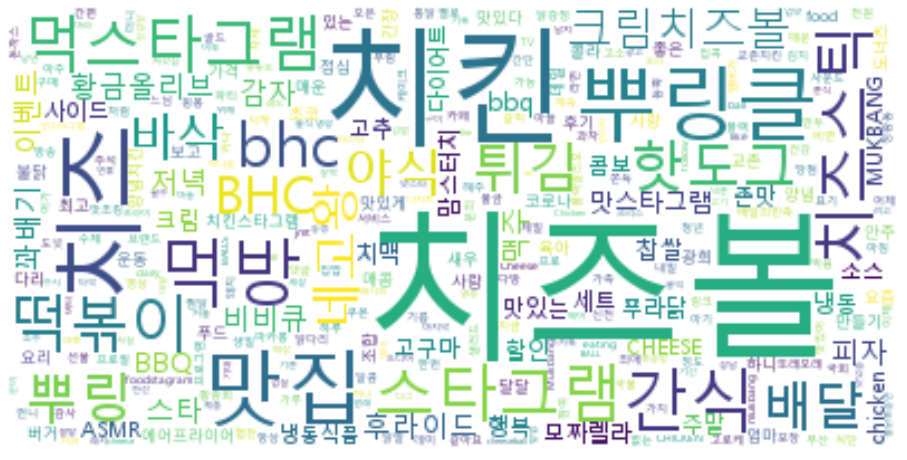

In [23]:
wordcloude_img = WordCloud(background_color = 'white', max_words=300, font_path=fontpath).generate_from_frequencies(textdict)
plt.figure(figsize=(16,16))
plt.imshow(wordcloude_img, interpolation='bilinear')
plt.axis('off')
plt.show()